In [1]:
import pickle

with open('/sise/home/etaylor/images/trichomes_patches/week5_3xzoom_regular_best_images/analysis/SAM_pred.pickle', 'rb') as f:
    SAM_pred = pickle.load(f)

with open('/sise/home/etaylor/images/trichomes_patches/week5_3xzoom_regular_best_images/analysis/ground_truth.pickle', 'rb') as f:
    ground_truth = pickle.load(f)

In [2]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2
import os
import seaborn as sns
import matplotlib.patches as patches
import sys
sys.path.append("..")

In [6]:
from dl_segmentation.sam_measurments import *
from annotations.ploting import *

## Filter Trichomes by the size

In [ ]:
def calculate_bounding_boxes(instance_bitmap):
    """
    Calculate bounding boxes for each object in the instance_bitmap.

    Args:
    - instance_bitmap (numpy.ndarray): The instance segmentation bitmap.

    Returns:
    - dict: A dictionary with object indices as keys and bounding boxes as values.
            Each bounding box is represented as a tuple: (min_row, min_col, max_row, max_col).
    """
    # Identify the unique segment values (excluding the background)
    unique_segments = np.unique(instance_bitmap)
    unique_segments = unique_segments[unique_segments != 0]

    bounding_boxes = {}

    # Compute bounding box for each segment
    for segment in unique_segments:
        rows, cols = np.where(instance_bitmap == segment)
        min_row, max_row = np.min(rows), np.max(rows)
        min_col, max_col = np.min(cols), np.max(cols)

        bounding_boxes[segment] = (min_row, min_col, max_row, max_col)

    return bounding_boxes


def add_bboxes_to_data(ground_truth):
    """
    Add bounding box data to each entry in the ground_truth dictionary.
    """
    for key, data in ground_truth.items():
        instance_bitmap = data['instance_bitmap']
        bboxes = calculate_bounding_boxes(instance_bitmap)
        ground_truth[key]['bbox'] = bboxes

    return ground_truth


def bounding_box_stats(image_data):
    """
    Calculate min, max, average, and standard deviation of bounding box sizes for a single image.

    Args:
    - image_data (dict): Dictionary containing data for a single image, including bounding boxes.

    Returns:
    - dict: A dictionary containing min, max, average, and standard deviation for height, width, and area.
    """
    bboxes = image_data['bbox']

    # Extract height, width, and area for each bounding box
    heights = [(max_row - min_row + 1) for min_row, _, max_row, _ in bboxes.values()]
    widths = [(max_col - min_col + 1) for _, min_col, _, max_col in bboxes.values()]
    areas = [h * w for h, w in zip(heights, widths)]

    # Calculate statistics
    stats = {
        "Height": {"Min": np.min(heights), "Max": np.max(heights), "Avg": np.mean(heights), "Std": np.std(heights)},
        "Width": {"Min": np.min(widths), "Max": np.max(widths), "Avg": np.mean(widths), "Std": np.std(widths)},
        "Area": {"Min": np.min(areas), "Max": np.max(areas), "Avg": np.mean(areas), "Std": np.std(areas)}
    }

    return stats


def all_images_bbox_stats(ground_truth):
    """
    Calculate bounding box statistics for all images in the ground_truth dictionary.

    Args:
    - ground_truth (dict): The ground truth data dictionary.

    Returns:
    - dict: A dictionary where each key is an image name and the value contains bounding box statistics for that image.
    """
    stats_dict = {}

    for key, image_data in ground_truth.items():
        stats = bounding_box_stats(image_data)
        stats_dict[key] = stats

    return stats_dict

def aggregate_bbox_stats(ground_truth):
    """
    Calculate aggregated bounding box statistics across all images in the ground_truth dictionary.

    Args:
    - ground_truth (dict): The ground truth data dictionary.

    Returns:
    - dict: A dictionary containing aggregated min, max, average, and standard deviation for height, width, and area.
    """
    all_heights = []
    all_widths = []
    all_areas = []

    # Collect dimensions from all images
    for image_data in ground_truth.values():
        bboxes = image_data['bbox']

        heights = [(max_row - min_row + 1) for min_row, _, max_row, _ in bboxes.values()]
        widths = [(max_col - min_col + 1) for _, min_col, _, max_col in bboxes.values()]
        areas = [h * w for h, w in zip(heights, widths)]

        all_heights.extend(heights)
        all_widths.extend(widths)
        all_areas.extend(areas)

    # Calculate aggregated statistics
    aggregated_stats = {
        "Height": {"Min": np.min(all_heights), "Max": np.max(all_heights), "Avg": np.mean(all_heights), "Std": np.std(all_heights)},
        "Width": {"Min": np.min(all_widths), "Max": np.max(all_widths), "Avg": np.mean(all_widths), "Std": np.std(all_widths)},
        "Area": {"Min": np.min(all_areas), "Max": np.max(all_areas), "Avg": np.mean(all_areas), "Std": np.std(all_areas)}
    }

    return aggregated_stats

In [ ]:
updated_ground_truth = add_bboxes_to_data(ground_truth)
# Testing the function on our sample ground_truth
aggregate_stats_sample = aggregate_bbox_stats(updated_ground_truth)
aggregate_stats_sample

{'Height': {'Min': 1,
  'Max': 268,
  'Avg': 40.98545935228024,
  'Std': 16.599510263317697},
 'Width': {'Min': 1,
  'Max': 179,
  'Avg': 38.8512888301388,
  'Std': 13.461888138187138},
 'Area': {'Min': 1,
  'Max': 35912,
  'Avg': 1729.8935888962326,
  'Std': 1604.6999764607963}}

### Experiments

1. Filter SAM_pred based on the agg bbox stats score
2. Filter SAM_pred based on each image bbox stats

For each we will compare results based on avg + std * factor

In [ ]:
def filter_predictions_based_on_bbox(pred_data, aggregate_stats, factor=0):
    """
    Filter predictions based on aggregated bounding box statistics.
    """
    filtered_data = {}

    # Extract aggregate statistics
    avg_height = aggregate_stats["Height"]["Avg"]
    std_height = aggregate_stats["Height"]["Std"]
    avg_width = aggregate_stats["Width"]["Avg"]
    std_width = aggregate_stats["Width"]["Std"]

    # Set the filtering thresholds
    min_height = avg_height - factor * std_height
    max_height = avg_height + factor * std_height
    min_width = avg_width - factor * std_width
    max_width = avg_width + factor * std_width

    for img_name, data in pred_data.items():
        filtered_segments = []
        for segment in data['mask']:
            bbox = segment['bbox']
            height = bbox[2]
            width = bbox[3]
            if min_height <= height <= max_height and min_width <= width <= max_width:
                filtered_segments.append(segment)

        # Only add to the filtered data if there are segments left after filtering
        if filtered_segments:
            filtered_data[img_name] = data.copy()
            filtered_data[img_name]['mask'] = filtered_segments
            filtered_data[img_name]['num_segments'] = len(filtered_segments)

    return filtered_data

def filter_predictions_per_image(pred_data, ground_truth, factor=0):
    """
    Filter predictions based on per-image bounding box statistics.
    """
    filtered_data = {}

    for img_name, data in pred_data.items():
        if img_name not in ground_truth:
            continue  # If the image is not in ground truth, skip

        # Extract per-image bounding box statistics
        img_stats = bounding_box_stats(ground_truth[img_name])
        avg_height = img_stats["Height"]["Avg"]
        std_height = img_stats["Height"]["Std"]
        avg_width = img_stats["Width"]["Avg"]
        std_width = img_stats["Width"]["Std"]

        # Set the filtering thresholds
        min_height = avg_height - factor * std_height
        max_height = avg_height + factor * std_height
        min_width = avg_width - factor * std_width
        max_width = avg_width + factor * std_width

        filtered_segments = []
        for segment in data['mask']:
            bbox = segment['bbox']
            height = bbox[2]
            width = bbox[3]

            if min_height <= height <= max_height and min_width <= width <= max_width:
                filtered_segments.append(segment)

        # Only add to the filtered data if there are segments left after filtering
        if filtered_segments:
            filtered_data[img_name] = data.copy()
            filtered_data[img_name]['mask'] = filtered_segments
            filtered_data[img_name]['num_segments'] = len(filtered_segments)

    return filtered_data

def filter_predictions_based_on_exact_values(pred_data, aggregate_stats):
    """
    Filter predictions based on exact aggregated bounding box statistics.
    """
    filtered_data = {}

    # Extract exact aggregate statistics
    min_height = aggregate_stats["Height"]["Min"]
    max_height = aggregate_stats["Height"]["Max"]
    min_width = aggregate_stats["Width"]["Min"]
    max_width = aggregate_stats["Width"]["Max"]

    for img_name, data in pred_data.items():
        filtered_segments = []
        for segment in data['mask']:
            bbox = segment['bbox']
            height = bbox[2]
            width = bbox[3]
            if min_height <= height <= max_height and min_width <= width <= max_width:
                filtered_segments.append(segment)

        # Only add to the filtered data if there are segments left after filtering
        if filtered_segments:
            filtered_data[img_name] = data.copy()
            filtered_data[img_name]['mask'] = filtered_segments
            filtered_data[img_name]['num_segments'] = len(filtered_segments)

    return filtered_data

def filter_predictions_per_image_exact(pred_data, ground_truth):
    """
    Filter predictions based on exact per-image bounding box statistics.
    """
    filtered_data = {}

    for img_name, data in pred_data.items():
        if img_name not in ground_truth:
            continue  # If the image is not in ground truth, skip

        # Calculate per-image bounding box statistics
        img_stats = bounding_box_stats(ground_truth[img_name])
        min_height = img_stats["Height"]["Min"]
        max_height = img_stats["Height"]["Max"]
        min_width = img_stats["Width"]["Min"]
        max_width = img_stats["Width"]["Max"]

        filtered_segments = []
        for segment in data['mask']:
            bbox = segment['bbox']
            height = bbox[2]
            width = bbox[3]

            if min_height <= height <= max_height and min_width <= width <= max_width:
                filtered_segments.append(segment)

        # Only add to the filtered data if there are segments left after filtering
        if filtered_segments:
            filtered_data[img_name] = data.copy()
            filtered_data[img_name]['mask'] = filtered_segments
            filtered_data[img_name]['num_segments'] = len(filtered_segments)

    return filtered_data



In [ ]:
def assess_and_print_results(ground_truth, predictions, iou_threshold=0.5):
    """
    Calculate the segmentation assessment results and print them.

    Args:
    - ground_truth (dict): The ground truth data.
    - predictions (dict): The predictions data.
    - iou_threshold (float): The IOU threshold for segmentation assessment.

    Returns:
    - None
    """
    average_precision, average_recall, std_dev_precision, std_dev_recall, (total_TPs, total_FPs, total_FNs), _ = calculate_average_precision_recall(ground_truth, predictions, iou_threshold)

    print("Segmentation Assessment Results:")
    print("-" * 30)
    print(f"Average Precision: {average_precision:.4f} (Standard Deviation: {std_dev_precision:.4f})")
    print(f"Average Recall: {average_recall:.4f} (Standard Deviation: {std_dev_recall:.4f})")
    print("-" * 30)
    print(f"Total True Positives (TPs): {total_TPs}")
    print(f"Total False Positives (FPs): {total_FPs}")
    print(f"Total False Negatives (FNs): {total_FNs}")
    print("-" * 30)


In [ ]:
aggregate_stats_sample

{'Height': {'Min': 1,
  'Max': 268,
  'Avg': 40.98545935228024,
  'Std': 16.599510263317697},
 'Width': {'Min': 1,
  'Max': 179,
  'Avg': 38.8512888301388,
  'Std': 13.461888138187138},
 'Area': {'Min': 1,
  'Max': 35912,
  'Avg': 1729.8935888962326,
  'Std': 1604.6999764607963}}

#### Evaluate avg filter

In [ ]:
# Loop for aggregate stats filtering
print("Assessment using Aggregate BBox Stats:")
print("=" * 40)
for factor in range(1,4):  # Factors from 0 to 3
    print(f"Using factor (average + {factor} std):")
    filtered_data_agg = filter_predictions_based_on_bbox(SAM_pred, aggregate_stats_sample, factor=factor)
    assess_and_print_results(ground_truth, filtered_data_agg)

# Loop for per-image stats filtering
print("\nAssessment using Per-Image BBox Stats:")
print("=" * 40)
for factor in range(1,4):  # Factors from 0 to 3
    print(f"Using factor (average + {factor} std):")
    filtered_data_per_image = filter_predictions_per_image(SAM_pred, updated_ground_truth, factor=factor)
    assess_and_print_results(ground_truth, filtered_data_per_image)

Assessment using Aggregate BBox Stats:
Using factor (average + 1 std):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.7126 (Standard Deviation: 0.0964)
Average Recall: 0.7224 (Standard Deviation: 0.1220)
------------------------------
Total True Positives (TPs): 1088
Total False Positives (FPs): 446
Total False Negatives (FNs): 425
------------------------------
Using factor (average + 2 std):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.4827 (Standard Deviation: 0.0831)
Average Recall: 0.8816 (Standard Deviation: 0.1059)
------------------------------
Total True Positives (TPs): 1321
Total False Positives (FPs): 1423
Total False Negatives (FNs): 192
------------------------------
Using factor (average + 3 std):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.4230 (Standard Deviation: 0.0793)
Average Recall: 0.9100 (Standard Deviation: 0.0899)
-----------------------------

In [ ]:
# Loop for aggregate stats filtering
print("Assessment using Aggregate BBox Stats:")
print("=" * 40)
for factor in range(1,4):  # Factors from 0 to 3
    print(f"Using factor (average + {factor} std):")
    filtered_data_agg = filter_predictions_based_on_bbox(SAM_pred, aggregate_stats_sample, factor=factor)
    assess_and_print_results(ground_truth, filtered_data_agg)

# Loop for per-image stats filtering
print("\nAssessment using Per-Image BBox Stats:")
print("=" * 40)
for factor in range(1,4):  # Factors from 0 to 3
    print(f"Using factor (average + {factor} std):")
    filtered_data_per_image = filter_predictions_per_image(SAM_pred, updated_ground_truth, factor=factor)
    assess_and_print_results(ground_truth, filtered_data_per_image)

Assessment using Aggregate BBox Stats:
Using factor (average + 1 std):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.7126 (Standard Deviation: 0.0964)
Average Recall: 0.7224 (Standard Deviation: 0.1220)
------------------------------
Total True Positives (TPs): 1088
Total False Positives (FPs): 446
Total False Negatives (FNs): 425
------------------------------
Using factor (average + 2 std):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.4827 (Standard Deviation: 0.0831)
Average Recall: 0.8816 (Standard Deviation: 0.1059)
------------------------------
Total True Positives (TPs): 1321
Total False Positives (FPs): 1423
Total False Negatives (FNs): 192
------------------------------
Using factor (average + 3 std):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.4230 (Standard Deviation: 0.0793)
Average Recall: 0.9100 (Standard Deviation: 0.0899)
-----------------------------

In [ ]:
# Loop for aggregate stats filtering
print("Assessment using Aggregate BBox Stats:")
print("=" * 40)
factors = np.arange(0.8, 2.4, 0.4)  # Factors from 0.8 to 2 in increments of 0.4
for factor in factors:
    print(f"\nUsing factor (average + {factor:.2f} std):")
    filtered_data_agg = filter_predictions_based_on_bbox(SAM_pred, aggregate_stats_sample, factor=factor)
    assess_and_print_results(ground_truth, filtered_data_agg)

# Loop for per-image stats filtering
print("\nAssessment using Per-Image BBox Stats:")
print("=" * 40)
for factor in factors:
    print(f"\nUsing factor (average + {factor:.2f} std):")
    filtered_data_per_image = filter_predictions_per_image(SAM_pred, updated_ground_truth, factor=factor)
    assess_and_print_results(ground_truth, filtered_data_per_image)


Assessment using Aggregate BBox Stats:

Using factor (average + 0.80 std):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.7676 (Standard Deviation: 0.1013)
Average Recall: 0.6136 (Standard Deviation: 0.1133)
------------------------------
Total True Positives (TPs): 926
Total False Positives (FPs): 288
Total False Negatives (FNs): 587
------------------------------

Using factor (average + 1.20 std):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.6650 (Standard Deviation: 0.0909)
Average Recall: 0.7873 (Standard Deviation: 0.1120)
------------------------------
Total True Positives (TPs): 1186
Total False Positives (FPs): 603
Total False Negatives (FNs): 327
------------------------------

Using factor (average + 1.60 std):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.5765 (Standard Deviation: 0.0863)
Average Recall: 0.8494 (Standard Deviation: 0.1086)
-------------------

#### Evaluate Min-Max filter

In [ ]:
# Experiment using aggregate bbox stats
print("Assessment using Aggregate BBox Stats (Exact Min/Max):")
print("=" * 40)

filtered_data_agg_exact = filter_predictions_based_on_exact_values(SAM_pred, aggregate_stats_sample)
assess_and_print_results(ground_truth, filtered_data_agg_exact)

# Experiment using per-image bbox stats
print("\nAssessment using Per-Image BBox Stats (Exact Min/Max):")
print("=" * 40)

filtered_data_per_image_exact = filter_predictions_per_image_exact(SAM_pred, updated_ground_truth)
assess_and_print_results(ground_truth, filtered_data_per_image_exact)

Assessment using Aggregate BBox Stats (Exact Min/Max):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.3961 (Standard Deviation: 0.0726)
Average Recall: 0.9263 (Standard Deviation: 0.0833)
------------------------------
Total True Positives (TPs): 1389
Total False Positives (FPs): 2158
Total False Negatives (FNs): 124
------------------------------

Assessment using Per-Image BBox Stats (Exact Min/Max):
Segmentation Assessment Results:
------------------------------
Average Precision: 0.5930 (Standard Deviation: 0.1030)
Average Recall: 0.8314 (Standard Deviation: 0.0899)
------------------------------
Total True Positives (TPs): 1265
Total False Positives (FPs): 937
Total False Negatives (FNs): 248
------------------------------


**Assessment using Aggregate BBox Stats (based on average ± std):**
* The best Precision of  0.7676 is achieved with a factor of  0.80 std.
* The best Recall of 0.8816 is achieved with a factor of  2.00 std.

**Assessment using Per-Image BBox Stats (based on average ± std):**
* The best Precision of  0.8017 is achieved with a factor of  0.80 std.
* The best Recall of  0.8398 is achieved with a factor of  2.00 std.

**Assessment using Aggregate BBox Stats (Exact Min/Max):**
* Precision:  0.3961
* Recall: 0.9263

 **Assessment using Per-Image BBox Stats (Exact Min/Max):**
* Precision:  0.5930
* Recall:  0.8314

**Summary:**

If you prioritize precision, the best result is achieved using per-image bounding box statistics with a factor of 0.80 standard deviations, yielding a precision of 0.8017.

On the other hand, if recall is more important, using the aggregate bounding box statistics with exact min/max gives the highest recall of 0.9263.

If you want a balance between precision and recall, you might consider the results from the per-image bounding box statistics with a factor of 2.00 standard deviations, which gives a precision of 0.5995 and a recall of 0.8398.






#### Plot the images after filtering with mean size + std

In [ ]:
SAM_pred_filter_by_size = filter_predictions_based_on_bbox(SAM_pred, aggregate_stats_sample, factor=1)
assess_and_print_results(ground_truth, SAM_pred_filter_by_size)


for sample in ground_truth.keys():
  print(f"----------- Analysis for {sample} ----------- \n")
  plot_masks(ground_truth[sample], SAM_pred_filter_by_size[sample])

## Filter Trichomes with Classifier

Extract the positive and negative segments (trichomes) from the 50 image sample

In [ ]:
import os
from PIL import Image

def extract_positive_patches(ground_truth, image_dir):
    """
    Extract positive patches from the images based on ground truth bounding boxes.

    Args:
    - ground_truth (dict): The ground truth data.
    - image_dir (str): Directory containing the original images.

    Returns:
    - list: List of positive patches.
    """
    positive_patches = []

    for img_key, data in ground_truth.items():
        # Load the original image
        img_path = os.path.join(image_dir, img_key + '.jpg')
        if not os.path.exists(img_path):
            continue
        img = Image.open(img_path)

        # Extract positive patches based on bounding boxes
        for _, bbox in data['bbox'].items():
            min_row, min_col, max_row, max_col = bbox
            patch = img.crop((min_col, min_row, max_col, max_row))
            positive_patches.append(patch)

    return positive_patches

def compute_bbox_iou(boxA, boxB):
	# determine the (x, y)-coordinates of the intersection rectangle
	xA = max(boxA[0], boxB[0])
	yA = max(boxA[1], boxB[1])
	xB = min(boxA[2], boxB[2])
	yB = min(boxA[3], boxB[3])
	# compute the area of intersection rectangle
	interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
	# compute the area of both the prediction and ground-truth
	# rectangles
	boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
	boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
	# compute the intersection over union by taking the intersection
	# area and dividing it by the sum of prediction + ground-truth
	# areas - the interesection area
	iou = interArea / float(boxAArea + boxBArea - interArea)
	# return the intersection over union value
	return iou

def extract_negative_patches(SAM_pred, ground_truth, image_dir, iou_threshold=0.5):
    """
    Extract negative patches from the images based on segments from SAM_pred and their IoU with ground_truth.

    Args:
    - SAM_pred (dict): The SAM prediction data.
    - ground_truth (dict): The ground truth data.
    - image_dir (str): Directory containing the original images.
    - iou_threshold (float): IoU threshold below which a segment is considered a negative patch.

    Returns:
    - list: List of negative patches.
    """
    negative_patches = []

    for img_key, data in SAM_pred.items():
        # Load the original image
        img_path = os.path.join(image_dir, img_key + '.jpg')
        if not os.path.exists(img_path):
            continue
        img = Image.open(img_path)

        gt_bboxes = list(ground_truth[img_key]['bbox'].values())

        # Evaluate each segment
        for segment in data['mask']:
            segment_bbox = segment['bbox']
            min_row, min_col, height, width = segment_bbox
            max_row = min_row + height
            max_col = min_col + width
            segment_bbox = (min_row, min_col, max_row, max_col)

            ious = [compute_bbox_iou(segment_bbox, gt_bbox) for gt_bbox in gt_bboxes]

            # If the segment's IoU with every ground truth bbox is below the threshold, it's a negative patch
            if all(iou < iou_threshold for iou in ious):
                patch = img.crop((min_col, min_row, max_col, max_row))
                negative_patches.append(patch)

    return negative_patches

In [ ]:
# This function is just a placeholder; you'll need to provide the actual path to your images.
images_path = "/content/drive/MyDrive/Thesis: Cannabis maturity assessment project/trichomes patches - week5 3xzoom"
positive_patches = extract_positive_patches(ground_truth, images_path)

# Checking the number of positive patches extracted
len(positive_patches)

1513

In [ ]:
# This function is also a placeholder; you'll need to provide the actual path to your images.
negative_patches = extract_negative_patches(SAM_pred, ground_truth, images_path)

# Checking the number of negative patches extracted
len(negative_patches)

3460

Build pandas df with the information

In [ ]:
import pandas as pd

# Convert lists of patches to lists of labels
positive_labels = [1] * len(positive_patches)
negative_labels = [0] * len(negative_patches)

# Combine positive and negative patches and their labels
all_patches = positive_patches + negative_patches
all_labels = positive_labels + negative_labels

# Create a DataFrame
df = pd.DataFrame({
    'patch': all_patches,
    'label': all_labels
})

# Determine the number of samples in each class
num_pos = sum(df['label'] == 1)
num_neg = sum(df['label'] == 0)

# Undersample the class with more samples to equalize the number of samples in both classes
if num_pos > num_neg:
    df_pos = df[df['label'] == 1].sample(num_neg) # Randomly select 'num_neg' samples from the positive class
    df_neg = df[df['label'] == 0]
else:
    df_neg = df[df['label'] == 0].sample(num_pos) # Randomly select 'num_pos' samples from the negative class
    df_pos = df[df['label'] == 1]

# Combine the undersampled data
df_balanced = pd.concat([df_pos, df_neg])

# Shuffle the DataFrame for randomness
df_balanced = df_balanced.sample(frac=1).reset_index(drop=True)


#### Plotting unbalanced data

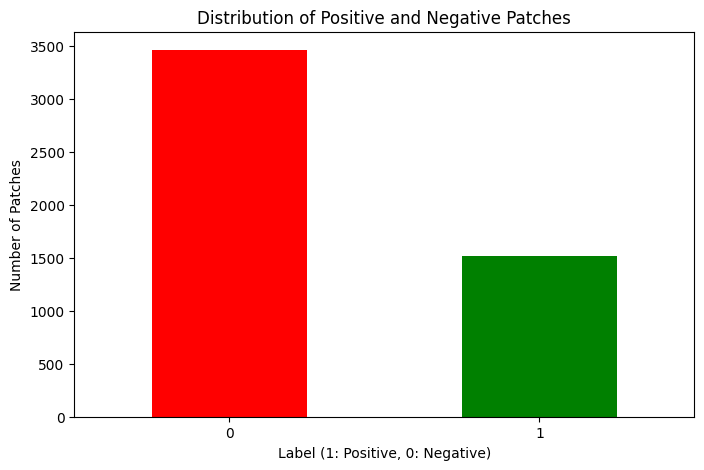

In [ ]:

# Count the occurrences of each label
label_counts = df['label'].value_counts()

# Plot the distribution
plt.figure(figsize=(8, 5))
label_counts.plot(kind='bar', color=['red', 'green'])
plt.title('Distribution of Positive and Negative Patches')
plt.xlabel('Label (1: Positive, 0: Negative)')
plt.ylabel('Number of Patches')
plt.xticks(rotation=0)
plt.show()


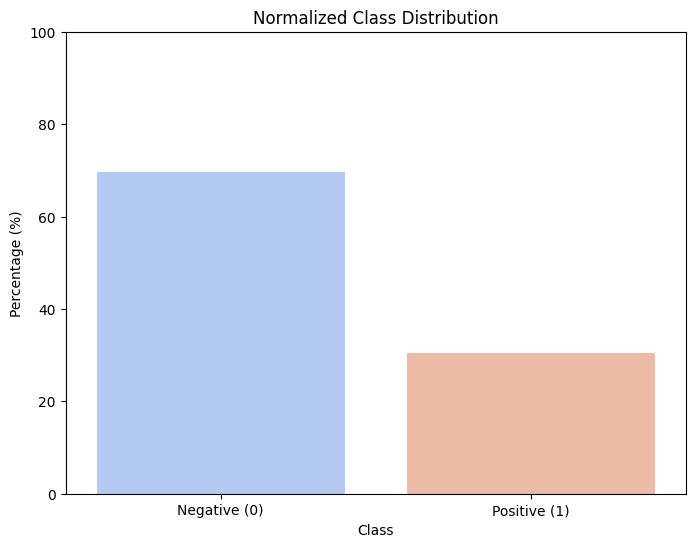

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate percentages
class_distribution = df['label'].value_counts(normalize=True) * 100

# Plot
plt.figure(figsize=(8, 6))
sns.barplot(x=class_distribution.index, y=class_distribution.values, palette="coolwarm")
plt.title("Normalized Class Distribution")
plt.xlabel("Class")
plt.ylabel("Percentage (%)")
plt.xticks(ticks=[0, 1], labels=['Negative (0)', 'Positive (1)'])
plt.ylim(0, 100)  # To ensure the y-axis starts from 0 and ends at 100
plt.show()


#### Plotting balanced data

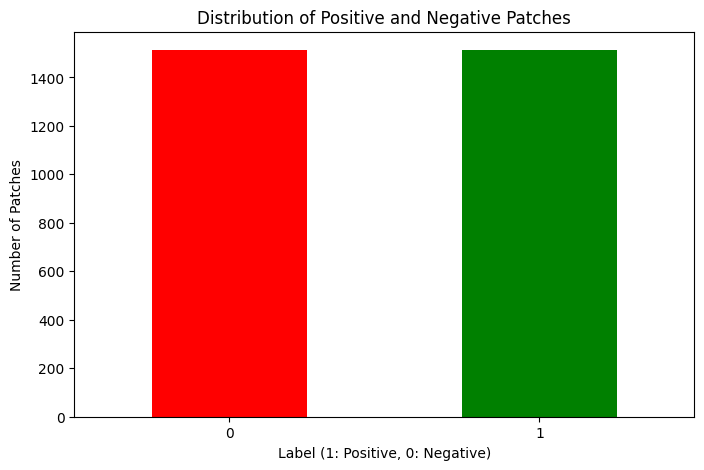

In [ ]:

# Count the occurrences of each label
label_counts = df_balanced['label'].value_counts()

# Plot the distribution
plt.figure(figsize=(8, 5))
label_counts.plot(kind='bar', color=['red', 'green'])
plt.title('Distribution of Positive and Negative Patches')
plt.xlabel('Label (1: Positive, 0: Negative)')
plt.ylabel('Number of Patches')
plt.xticks(rotation=0)
plt.show()

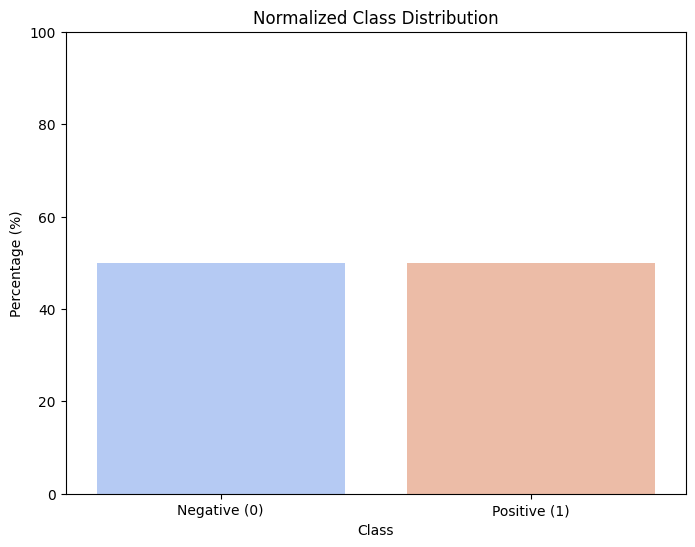

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate percentages
class_distribution = df_balanced['label'].value_counts(normalize=True) * 100

# Plot
plt.figure(figsize=(8, 6))
sns.barplot(x=class_distribution.index, y=class_distribution.values, palette="coolwarm")
plt.title("Normalized Class Distribution")
plt.xlabel("Class")
plt.ylabel("Percentage (%)")
plt.xticks(ticks=[0, 1], labels=['Negative (0)', 'Positive (1)'])
plt.ylim(0, 100)  # To ensure the y-axis starts from 0 and ends at 100
plt.show()


#### Train models on unbalanced data

##### Models Comparisons

We will start by compare the following five classifiers:

* **Logistic Regression**: A simple linear model for classification. It's quick to train and can serve as a good baseline.
* **Support Vector Machine (SVM)**: A powerful linear classifier that works by finding the best hyperplane that separates all data points of one class from those of the other class.
* **Random Forest**: An ensemble method that creates a 'forest' of decision trees and merges them together to get a more accurate and stable prediction.
* **K-Nearest Neighbors (KNN)**: A simple, instance-based learning algorithm that classifies a data point based on how its neighbors are classified.
* **Gradient Boosted Trees (XGBoost)**: An optimized gradient boosting library that's known for its performance and efficiency.

For the evaluation, we'll consider the following metrics:

* Accuracy
* Precision
* Recall
* F1-score

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
import numpy as np
from PIL import Image

print("Resizing images to a standard shape...")
standard_size = (64, 64)
resized_images = [img.resize(standard_size) for img in df['patch']]

print("Preparing data by flattening the resized images...")
X = np.array([np.array(img).flatten() for img in resized_images])
y = df['label'].values

print("Splitting the dataset into the Training set and Test set...")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("Scaling the features...")
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

print("Initializing classifiers...")
classifiers = {
    "Logistic Regression": LogisticRegression(max_iter=5000, random_state=42),
    "SVM": SVC(kernel='linear', random_state=42),
    "Random Forest": RandomForestClassifier(random_state=42),
    "KNN": KNeighborsClassifier(),
    "XGBoost": xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)
}

# Training and evaluation
results = {}
for name, clf in classifiers.items():
    print(f"Training and evaluating {name}...")
    # Train
    clf.fit(X_train, y_train)

    # Predict
    y_pred = clf.predict(X_test)

    # Evaluate
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    results[name] = {"Accuracy": accuracy, "Precision": precision, "Recall": recall, "F1": f1}
    print(f"Results for {name}:")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print("-" * 30)

print("All evaluations complete!")
results


Resizing images to a standard shape...
Preparing data by flattening the resized images...
Splitting the dataset into the Training set and Test set...
Scaling the features...
Initializing classifiers...
Training and evaluating Logistic Regression...


/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


Results for Logistic Regression:
Accuracy: 0.9487
Precision: 0.9124
Recall: 0.9321
F1 Score: 0.9221
------------------------------
Training and evaluating SVM...
Results for SVM:
Accuracy: 0.9377
Precision: 0.8786
Recall: 0.9383
F1 Score: 0.9075
------------------------------
Training and evaluating Random Forest...
Results for Random Forest:
Accuracy: 0.9367
Precision: 0.9365
Recall: 0.8642
F1 Score: 0.8989
------------------------------
Training and evaluating KNN...
Results for KNN:
Accuracy: 0.9286
Precision: 0.9317
Recall: 0.8426
F1 Score: 0.8849
------------------------------
Training and evaluating XGBoost...
Results for XGBoost:
Accuracy: 0.9578
Precision: 0.9490
Recall: 0.9198
F1 Score: 0.9342
------------------------------
All evaluations complete!


{'Logistic Regression': {'Accuracy': 0.9487437185929648,
  'Precision': 0.9123867069486404,
  'Recall': 0.9320987654320988,
  'F1': 0.9221374045801527},
 'SVM': {'Accuracy': 0.9376884422110553,
  'Precision': 0.8786127167630058,
  'Recall': 0.9382716049382716,
  'F1': 0.9074626865671642},
 'Random Forest': {'Accuracy': 0.9366834170854271,
  'Precision': 0.9364548494983278,
  'Recall': 0.8641975308641975,
  'F1': 0.898876404494382},
 'KNN': {'Accuracy': 0.928643216080402,
  'Precision': 0.931740614334471,
  'Recall': 0.8425925925925926,
  'F1': 0.8849270664505673},
 'XGBoost': {'Accuracy': 0.9577889447236181,
  'Precision': 0.9490445859872612,
  'Recall': 0.9197530864197531,
  'F1': 0.9341692789968652}}

#### Train models on balanced data

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
import numpy as np
from PIL import Image

print("Resizing images to a standard shape...")
standard_size = (64, 64)
resized_images = [img.resize(standard_size) for img in df_balanced['patch']]

print("Preparing data by flattening the resized images...")
X = np.array([np.array(img).flatten() for img in resized_images])
y = df_balanced['label'].values

print("Splitting the dataset into the Training set and Test set...")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("Scaling the features...")
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

print("Initializing classifiers...")
classifiers = {
    "Logistic Regression": LogisticRegression(max_iter=5000, random_state=42),
    "SVM": SVC(kernel='linear', random_state=42),
    "Random Forest": RandomForestClassifier(random_state=42),
    "KNN": KNeighborsClassifier(),
    "XGBoost": xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)
}

# Training and evaluation
results = {}
for name, clf in classifiers.items():
    print(f"Training and evaluating {name}...")
    # Train
    clf.fit(X_train, y_train)

    # Predict
    y_pred = clf.predict(X_test)

    # Evaluate
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    results[name] = {"Accuracy": accuracy, "Precision": precision, "Recall": recall, "F1": f1}
    print(f"Results for {name}:")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print("-" * 30)

print("All evaluations complete!")
results


Resizing images to a standard shape...
Preparing data by flattening the resized images...
Splitting the dataset into the Training set and Test set...
Scaling the features...
Initializing classifiers...
Training and evaluating Logistic Regression...


/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


Results for Logistic Regression:
Accuracy: 0.9274
Precision: 0.9076
Recall: 0.9450
F1 Score: 0.9259
------------------------------
Training and evaluating SVM...
Results for SVM:
Accuracy: 0.9043
Precision: 0.8870
Recall: 0.9175
F1 Score: 0.9020
------------------------------
Training and evaluating Random Forest...
Results for Random Forest:
Accuracy: 0.9290
Precision: 0.9397
Recall: 0.9107
F1 Score: 0.9250
------------------------------
Training and evaluating KNN...
Results for KNN:
Accuracy: 0.9059
Precision: 0.9209
Recall: 0.8797
F1 Score: 0.8998
------------------------------
Training and evaluating XGBoost...
Results for XGBoost:
Accuracy: 0.9290
Precision: 0.9366
Recall: 0.9141
F1 Score: 0.9252
------------------------------
All evaluations complete!


{'Logistic Regression': {'Accuracy': 0.9273927392739274,
  'Precision': 0.9075907590759076,
  'Recall': 0.9450171821305842,
  'F1': 0.9259259259259259},
 'SVM': {'Accuracy': 0.9042904290429042,
  'Precision': 0.8870431893687708,
  'Recall': 0.9175257731958762,
  'F1': 0.902027027027027},
 'Random Forest': {'Accuracy': 0.929042904290429,
  'Precision': 0.9397163120567376,
  'Recall': 0.9106529209621993,
  'F1': 0.924956369982548},
 'KNN': {'Accuracy': 0.905940594059406,
  'Precision': 0.920863309352518,
  'Recall': 0.8797250859106529,
  'F1': 0.8998242530755712},
 'XGBoost': {'Accuracy': 0.929042904290429,
  'Precision': 0.9366197183098591,
  'Recall': 0.9140893470790378,
  'F1': 0.9252173913043478}}

### Filter Segments with Classifier

In [ ]:
from PIL import Image

# Load image
def load_image(image_path):
    return Image.open(image_path)

# Extract segments and their references from SAM predictions
def extract_segment_patches(SAM_pred, image_dir):
    """Extract segments from SAM predictions and return their references."""
    segments = []
    references = []  # To store reference back to SAM_pred

    for img_key, data in SAM_pred.items():
        img_path = os.path.join(image_dir, img_key + '.jpg')
        if not os.path.exists(img_path):
            continue
        img = load_image(img_path)

        for idx, segment in enumerate(data['mask']):
            segment_bbox = segment['bbox']
            min_row, min_col, height, width = segment_bbox
            max_row = min_row + height
            max_col = min_col + width
            patch = img.crop((min_col, min_row, max_col, max_row))
            segments.append(patch)
            references.append((img_key, idx))

    return segments, references

# Filter out invalid segments from SAM_pred based on classifier results
def filter_invalid_segments(SAM_pred, valid_indices, references):
    """Filter out invalid segments from SAM_pred based on valid_indices."""
    filtered_SAM_pred = SAM_pred.copy()

    # Initialize a dictionary to store valid segments for each image
    valid_segments_dict = {}

    for valid_idx in valid_indices:
        img_key, idx = references[valid_idx]
        if img_key not in valid_segments_dict:
            valid_segments_dict[img_key] = []
        valid_segments_dict[img_key].append(filtered_SAM_pred[img_key]['mask'][idx])

    # Replace the mask in filtered_SAM_pred with the valid segments
    for img_key, valid_segments in valid_segments_dict.items():
        if img_key in filtered_SAM_pred:
            filtered_SAM_pred[img_key]['mask'] = valid_segments

    return filtered_SAM_pred

##### Read `SAM_pred` again when filtered

In [ ]:
with open('/content/drive/MyDrive/Thesis: Cannabis maturity assessment project/trichomes patches - week5 3xzoom/analysis/SAM_pred.pickle', 'rb') as f:
    SAM_pred = pickle.load(f)

In [ ]:
# Classifier (for demonstration, replace with your trained classifier)
classifier = classifiers['Random Forest']

# Extract segments and references
segments, references = extract_segment_patches(SAM_pred, images_path)
print(len(segments))

# Resize the segments
standard_size = (64, 64)
resized_segments = [img.resize(standard_size) for img in segments]

# Preprocess and flatten
X = [np.array(img).flatten() for img in resized_segments]
X = scaler.transform(X)  # Use the same scaler object you used during training

predictions = classifier.predict(X)

# Filter out invalid segments based on classifier results
valid_indices = [i for i, pred in enumerate(predictions) if pred == 1]

# Get indices of invalid segments
invalid_indices = [i for i, pred in enumerate(predictions) if pred == 0]

filtered_SAM_pred = filter_invalid_segments(SAM_pred, valid_indices, references)

3605


In [ ]:
print("Model prediction for all the segments:")
print(f"Amount of valid segmentslen {len(valid_indices)}")
print(f"Amount of invalid segmentslen {len(invalid_indices)}")

Model prediction for all the segments:
Amount of valid segmentslen 219
Amount of invalid segmentslen 3386


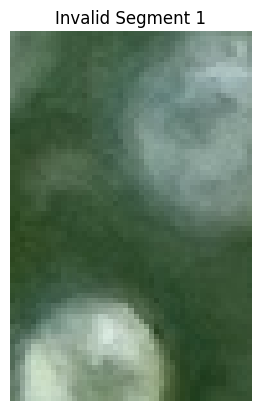

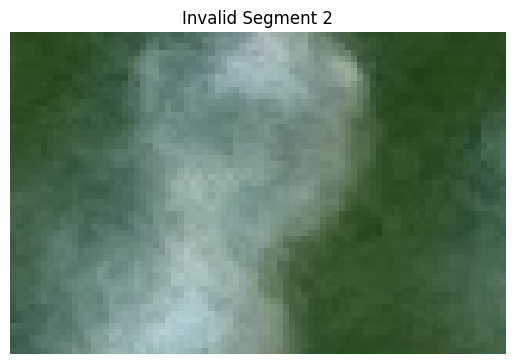

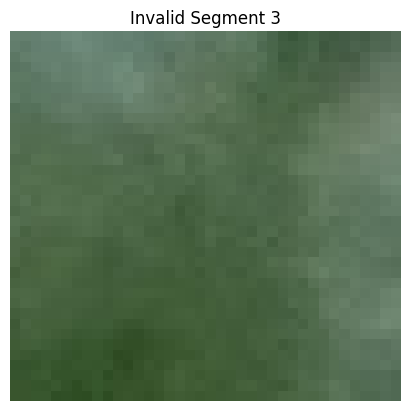

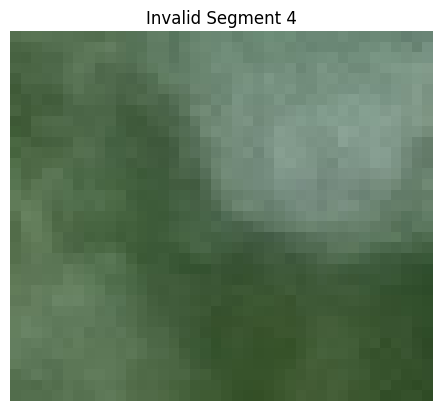

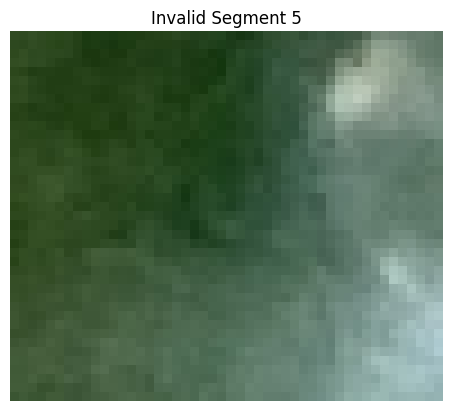

...

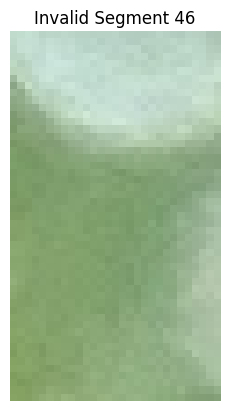

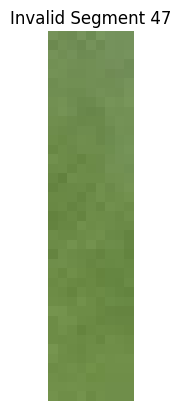

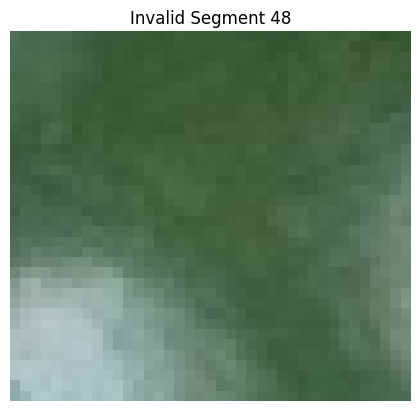

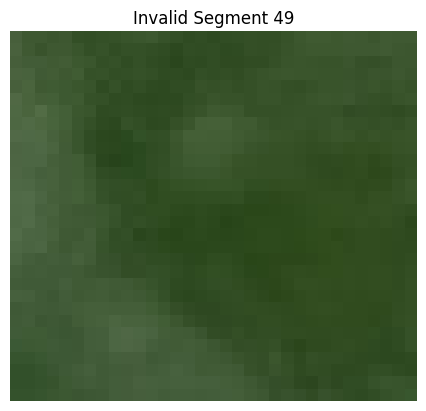

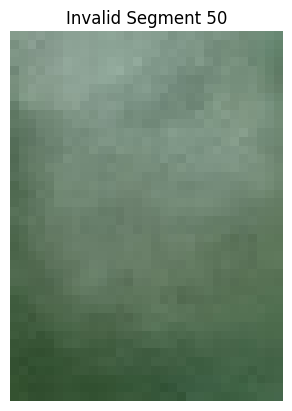

In [ ]:
# Get indices of invalid segments
invalid_indices = [i for i, pred in enumerate(predictions) if pred == 0]

# Extract invalid segments
invalid_segments = [segments[i] for i in invalid_indices]

# Visualize the first few invalid segments
for i, segment in enumerate(invalid_segments[:50]):
    plt.imshow(segment)
    plt.title(f"Invalid Segment {i+1}")
    plt.axis('off')
    plt.show()


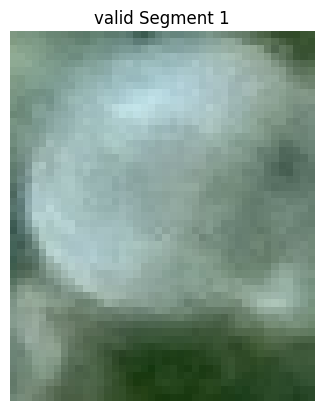

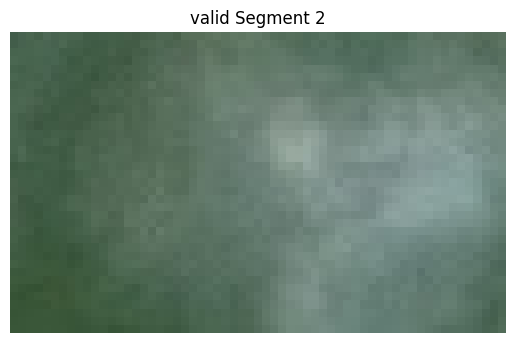

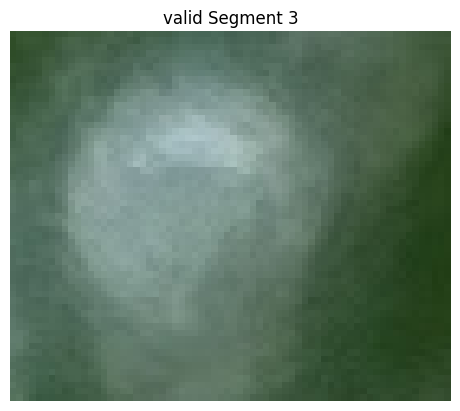

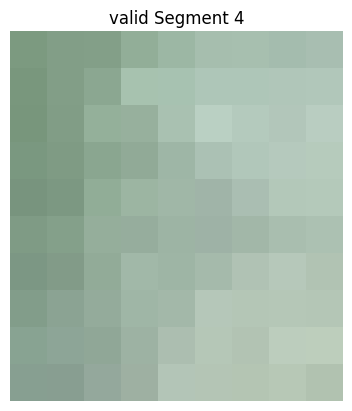

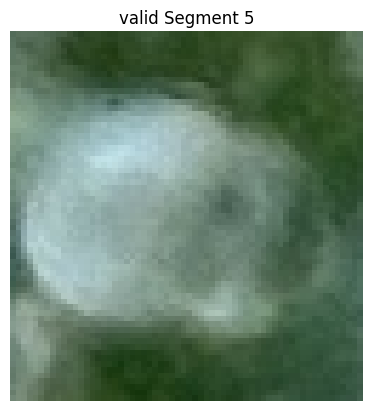

...

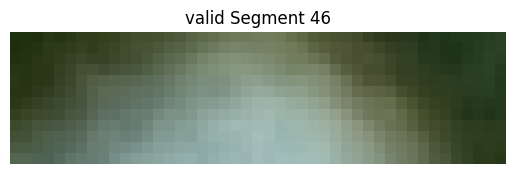

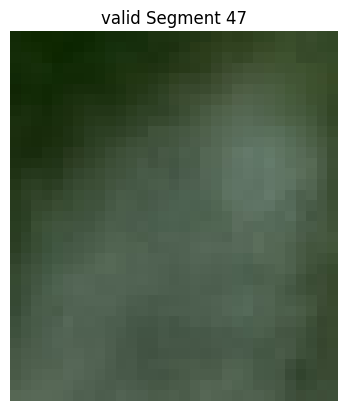

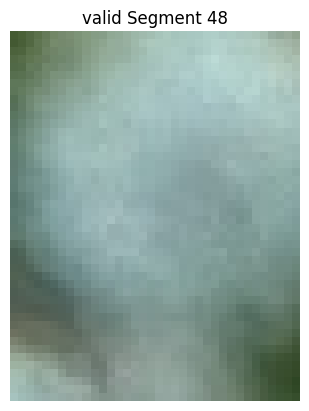

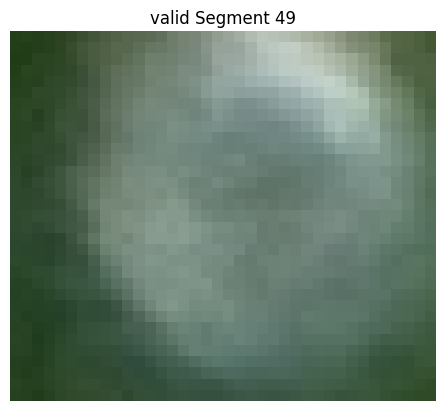

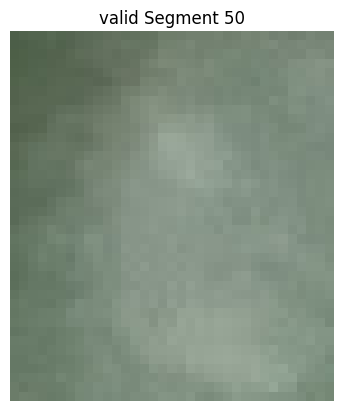

In [ ]:
# Get indices of valid segments
valid_indices = [i for i, pred in enumerate(predictions) if pred == 1]

# Extract valid segments
valid_segments = [segments[i] for i in valid_indices]

# Visualize the first few valid segments
for i, segment in enumerate(valid_segments[:50]):
    plt.imshow(segment)
    plt.title(f"valid Segment {i+1}")
    plt.axis('off')
    plt.show()

It seems like that most of the segments classified to non valid - probabliy because that the data is unblanaced.
Lets check the train test split to see the distribution of the data that we trainned on.

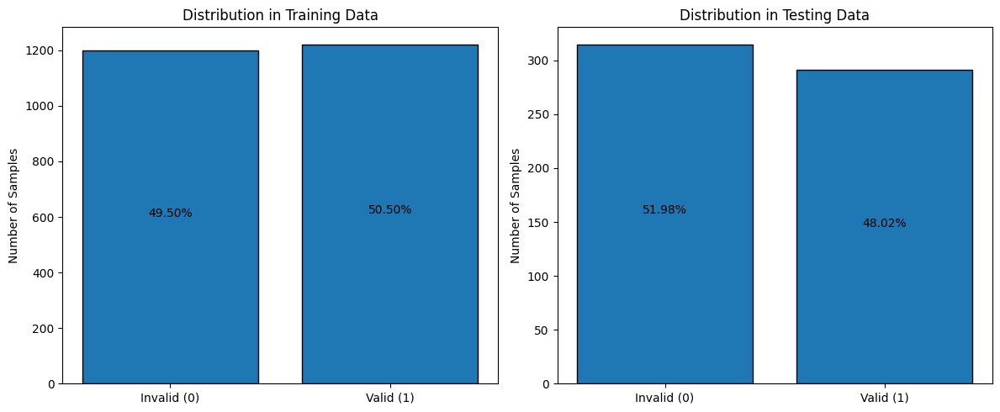

In [ ]:
import matplotlib.pyplot as plt

# Calculate the percentage of each class
train_percent_invalid = (y_train == 0).sum() / len(y_train) * 100
train_percent_valid = (y_train == 1).sum() / len(y_train) * 100

test_percent_invalid = (y_test == 0).sum() / len(y_test) * 100
test_percent_valid = (y_test == 1).sum() / len(y_test) * 100

# Plotting the distribution
fig, ax = plt.subplots(1, 2, figsize=(12, 5))

# Distribution for y_train
counts, bins, patches = ax[0].hist(y_train, bins=[-0.5, 0.5, 1.5], edgecolor="k", align='mid', rwidth=0.8)
ax[0].set_xticks([0, 1])
ax[0].set_xticklabels(["Invalid (0)", "Valid (1)"])
ax[0].set_title("Distribution in Training Data")
ax[0].set_ylabel("Number of Samples")
ax[0].annotate(f'{train_percent_invalid:.2f}%', xy=(0, counts[0] / 2), ha='center')
ax[0].annotate(f'{train_percent_valid:.2f}%', xy=(1, counts[1] / 2), ha='center')

# Distribution for y_test
counts, bins, patches = ax[1].hist(y_test, bins=[-0.5, 0.5, 1.5], edgecolor="k", align='mid', rwidth=0.8)
ax[1].set_xticks([0, 1])
ax[1].set_xticklabels(["Invalid (0)", "Valid (1)"])
ax[1].set_title("Distribution in Testing Data")
ax[1].set_ylabel("Number of Samples")
ax[1].annotate(f'{test_percent_invalid:.2f}%', xy=(0, counts[0] / 2), ha='center')
ax[1].annotate(f'{test_percent_valid:.2f}%', xy=(1, counts[1] / 2), ha='center')

plt.tight_layout()
plt.show()


#TODO

* Try to train the  classifiers with balanced data - remove some data from the invalid segments.
* Try to think why the results werenwt good - maybe it is not the unbalanced data?
* Start working on other Image segmentation models.
* I can start working on the auto labeler notbook with the SAM Moddel with filtering - recieved around of 75% for both precision and recall.
* Pre process to patches the images from the other weeks.
* Start working from the cluster instead of the of google colab


### Experiments - different IoU

In [ ]:
# List of IoU values to evaluate
iou_values = [0.2, 0.4, 0.5, 0.7]

# Assess the filtering process using the classifier
print("Assessment after Classifier-based Filtering:")
print("=" * 40)

for iou in iou_values:
    print(f"Using IoU threshold: {iou}")
    assess_and_print_results(ground_truth, filtered_SAM_pred, iou_threshold=iou)
    print("\n")

Assessment after Classifier-based Filtering:
Using IoU threshold: 0.2
Segmentation Assessment Results:
------------------------------
Average Precision: 0.6911 (Standard Deviation: 0.2885)
Average Recall: 0.1567 (Standard Deviation: 0.2173)
------------------------------
Total True Positives (TPs): 203
Total False Positives (FPs): 152
Total False Negatives (FNs): 1310
------------------------------


Using IoU threshold: 0.4
Segmentation Assessment Results:
------------------------------
Average Precision: 0.6504 (Standard Deviation: 0.2920)
Average Recall: 0.1497 (Standard Deviation: 0.2162)
------------------------------
Total True Positives (TPs): 192
Total False Positives (FPs): 163
Total False Negatives (FNs): 1321
------------------------------


Using IoU threshold: 0.5
Segmentation Assessment Results:
------------------------------
Average Precision: 0.5762 (Standard Deviation: 0.3047)
Average Recall: 0.1428 (Standard Deviation: 0.2176)
------------------------------
Total True

----------- Analysis for IMG_0003_p18 ----------- 



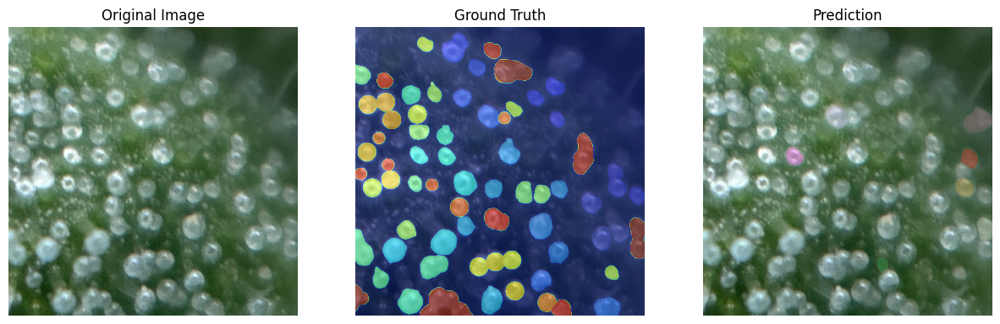

----------- Analysis for IMG_0003_p26 ----------- 



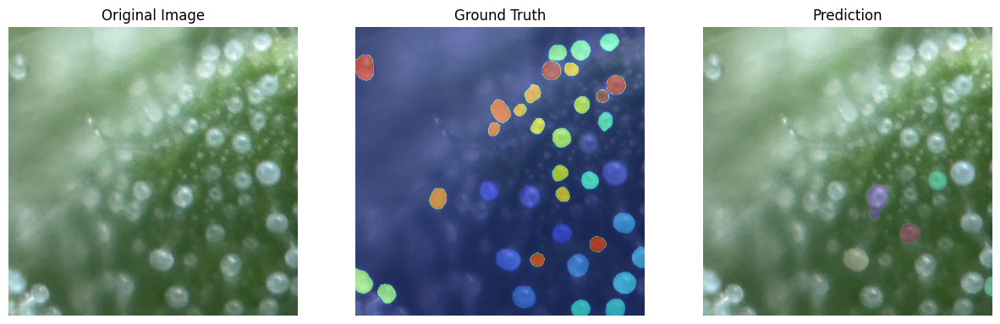

----------- Analysis for IMG_0003_p27 ----------- 



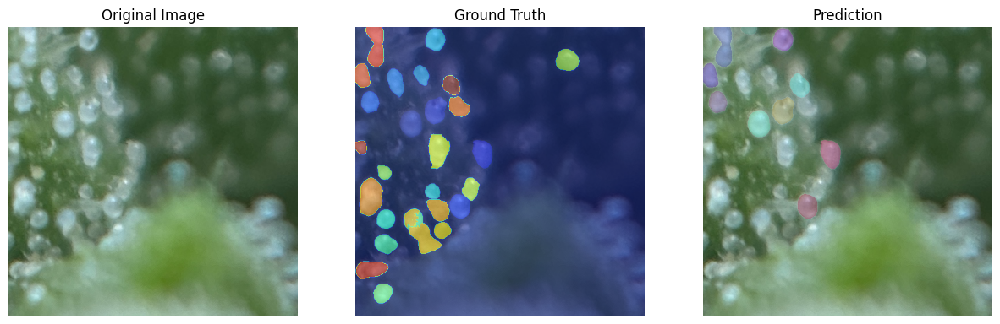

----------- Analysis for IMG_0003_p2 ----------- 



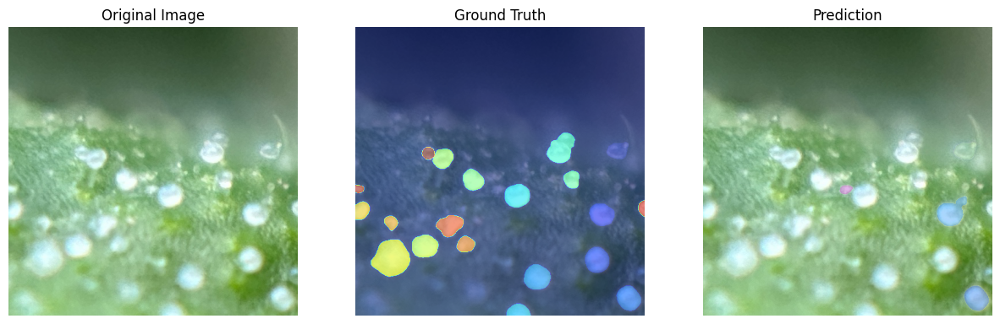

----------- Analysis for IMG_0003_p30 ----------- 



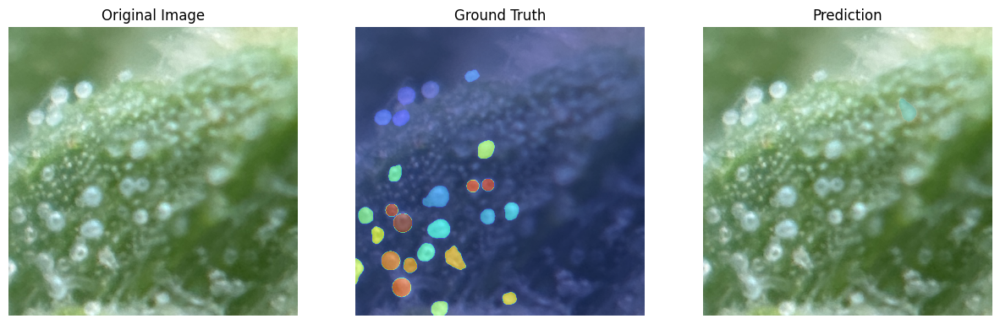

----------- Analysis for IMG_0003_p31 ----------- 



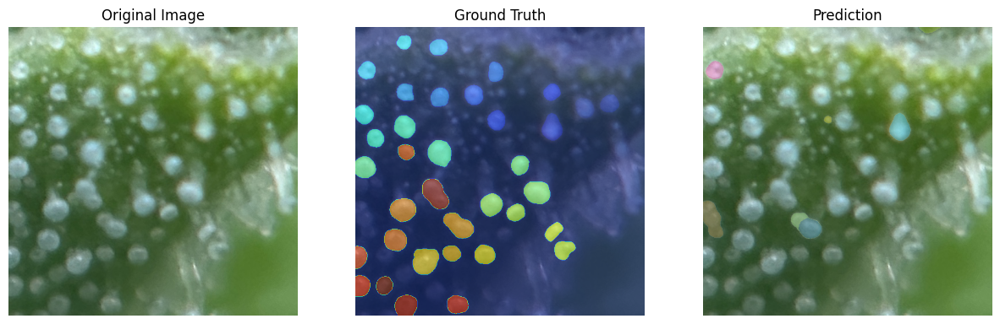

----------- Analysis for IMG_0003_p32 ----------- 



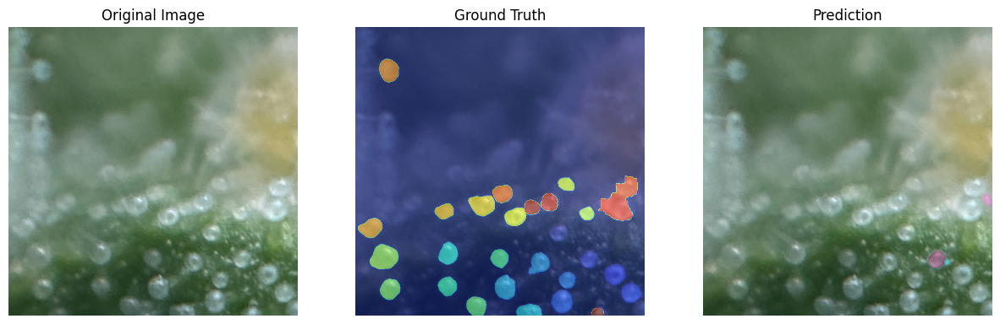

----------- Analysis for IMG_0003_p6 ----------- 



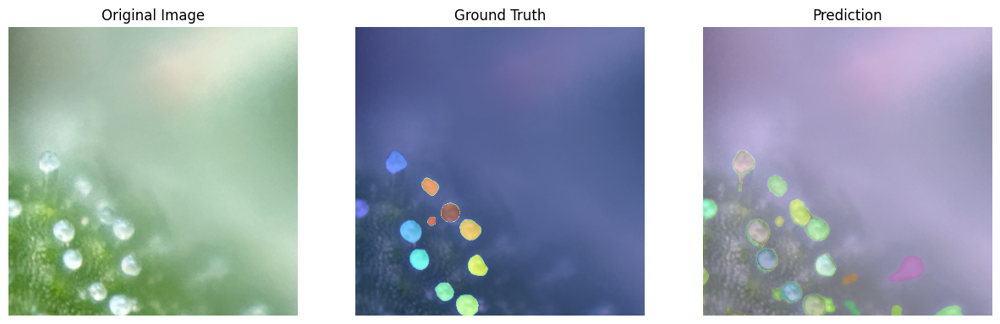

----------- Analysis for IMG_0003_p7 ----------- 



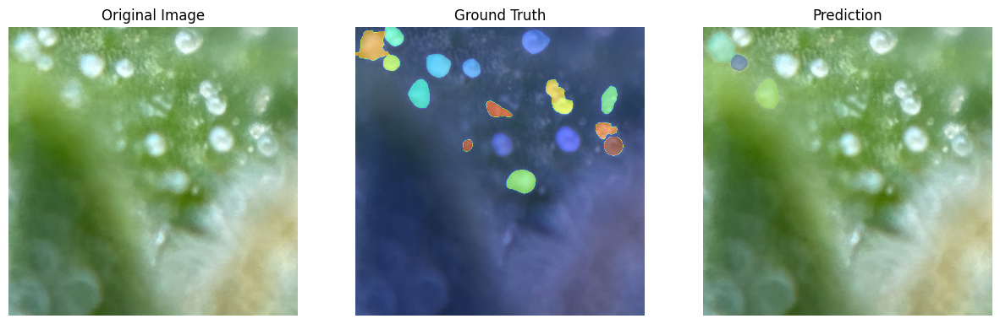

----------- Analysis for IMG_0021_p11 ----------- 



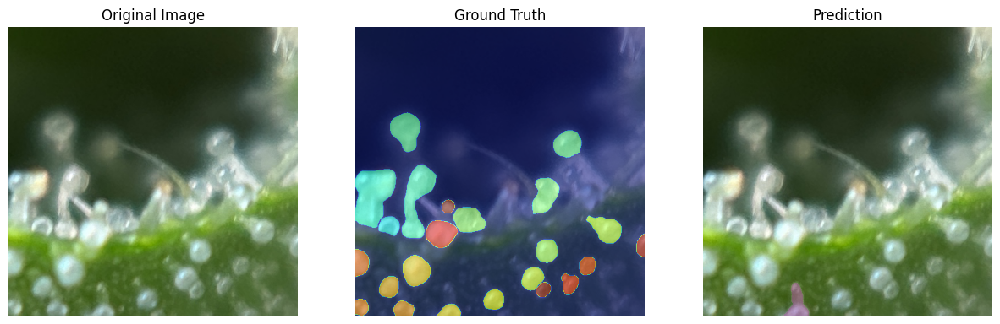

----------- Analysis for IMG_0021_p23 ----------- 



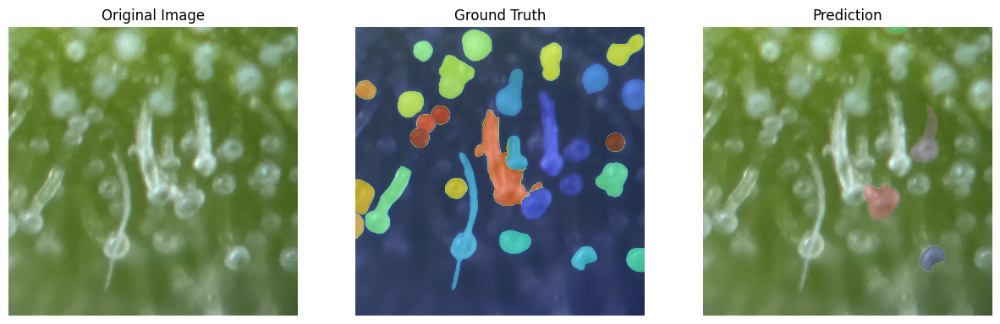

----------- Analysis for IMG_0021_p27 ----------- 



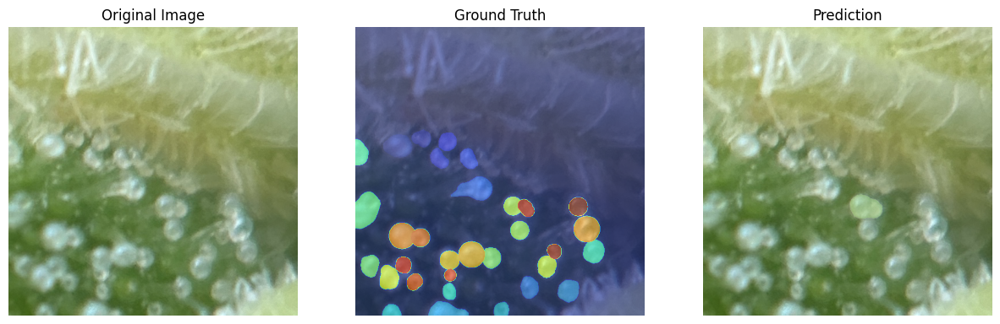

----------- Analysis for IMG_0021_p6 ----------- 



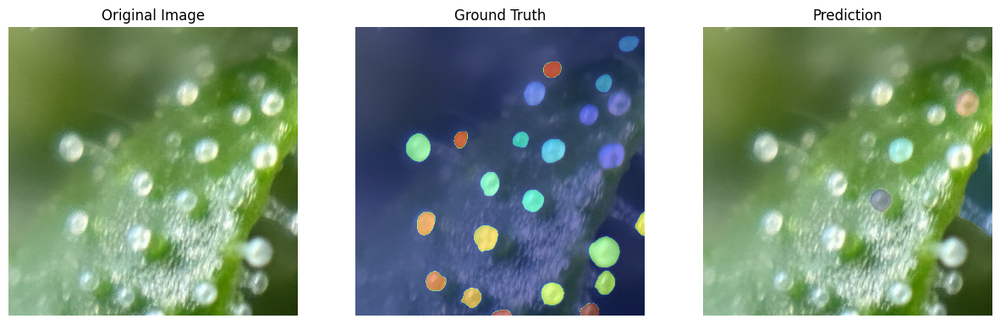

----------- Analysis for IMG_0021_p7 ----------- 



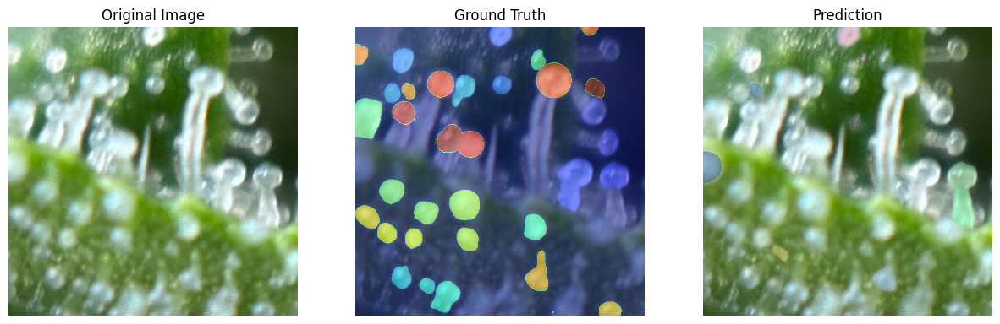

----------- Analysis for IMG_0023_p29 ----------- 



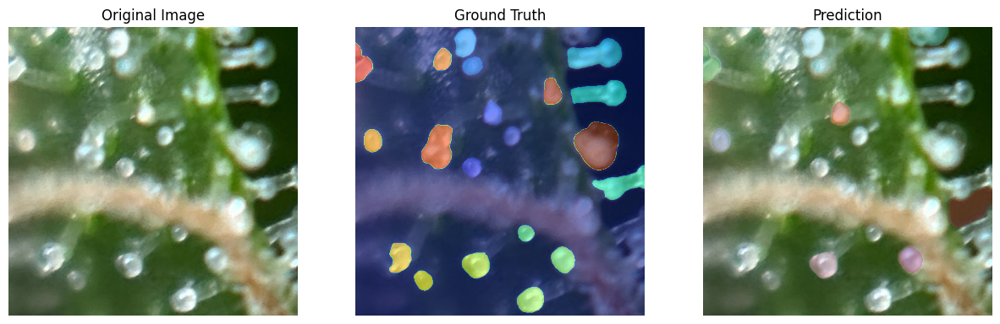

----------- Analysis for IMG_0023_p2 ----------- 



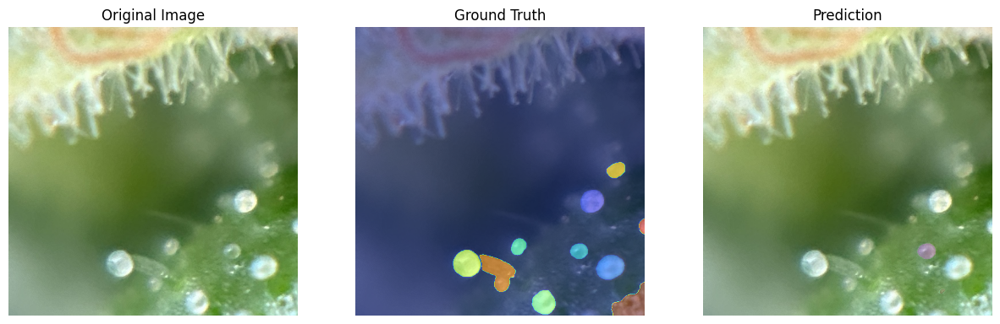

----------- Analysis for IMG_0023_p30 ----------- 



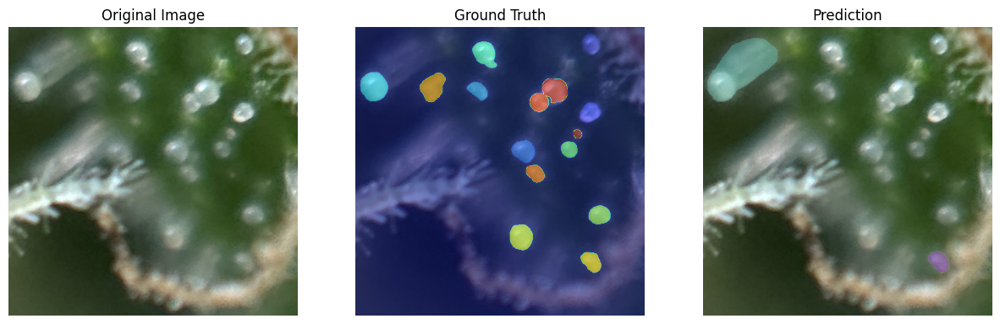

----------- Analysis for IMG_0023_p31 ----------- 



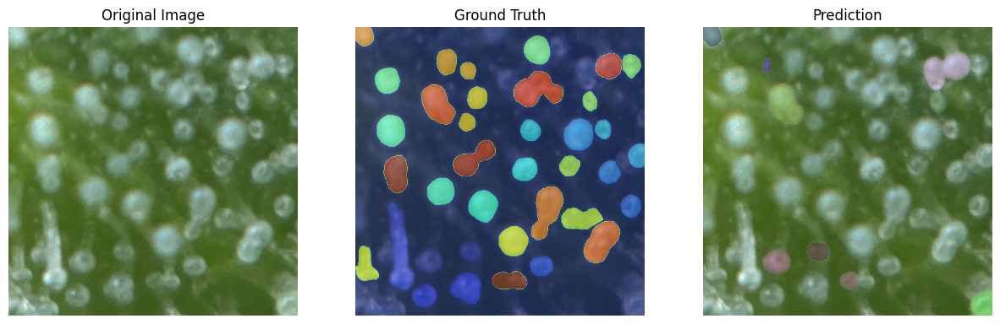

----------- Analysis for IMG_0023_p8 ----------- 



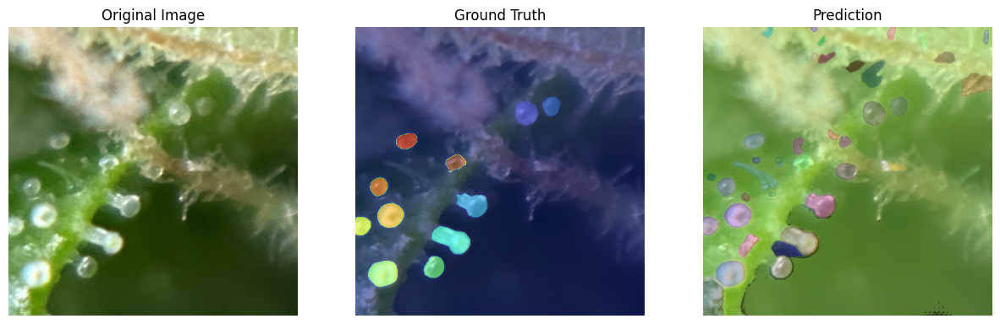

----------- Analysis for IMG_0044_p16 ----------- 



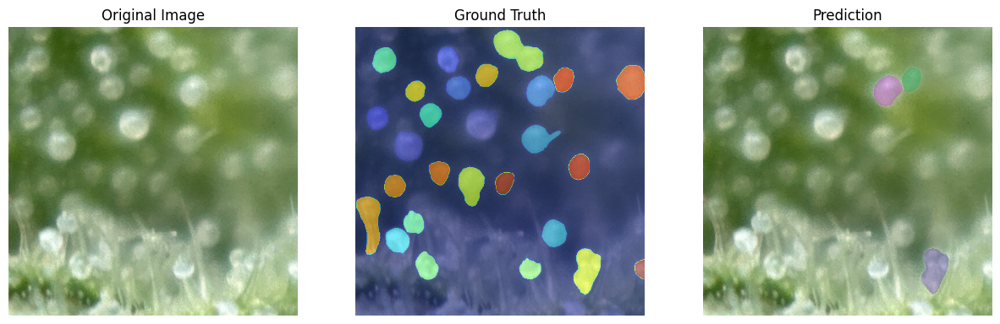

----------- Analysis for IMG_0044_p18 ----------- 



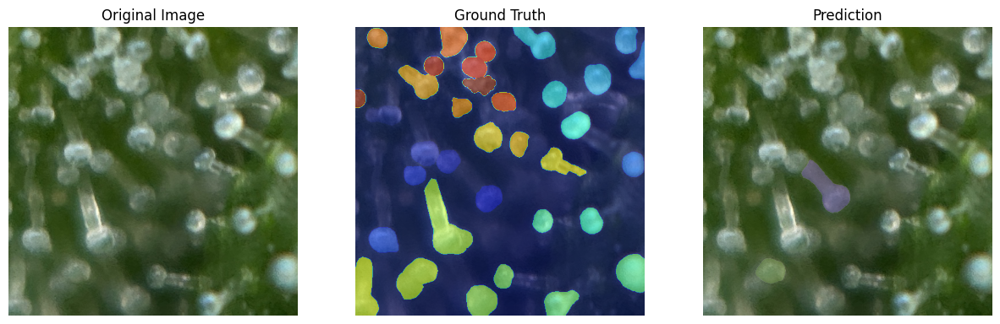

----------- Analysis for IMG_0044_p20 ----------- 



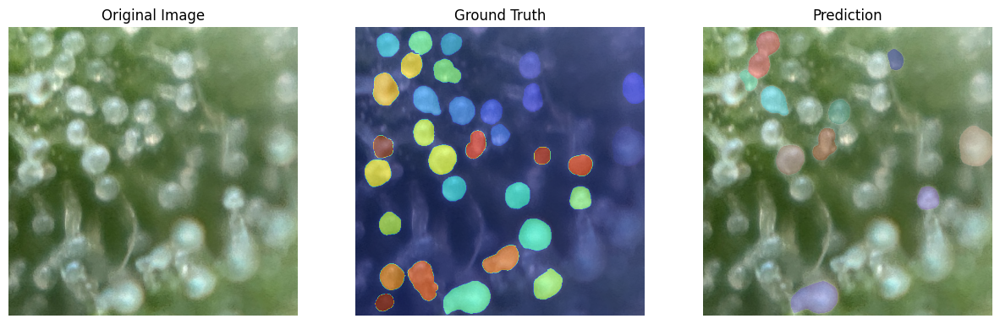

----------- Analysis for IMG_0044_p4 ----------- 



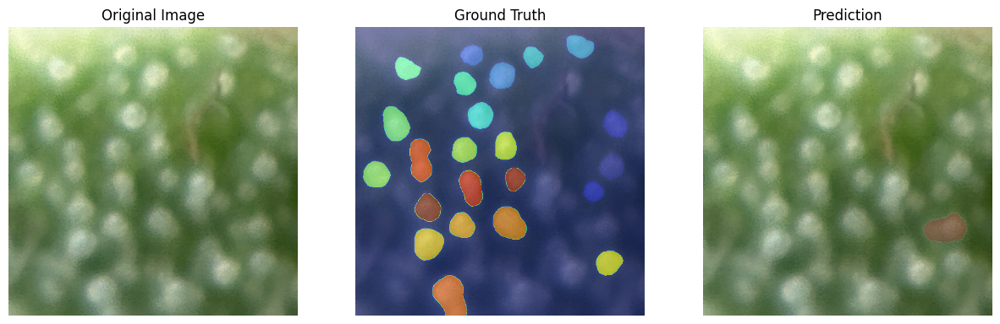

----------- Analysis for IMG_0044_p5 ----------- 



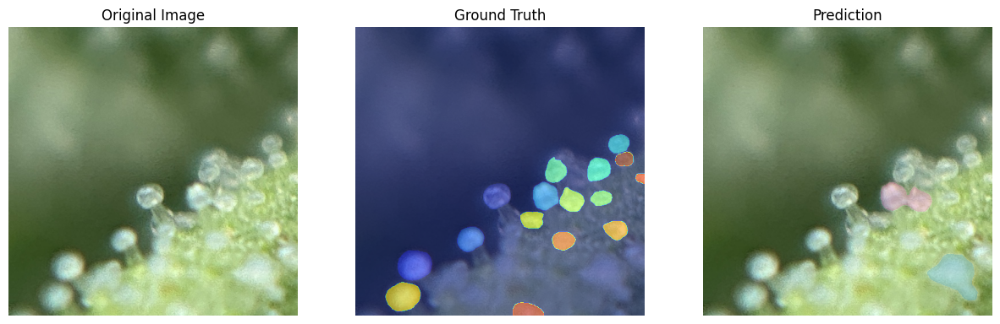

----------- Analysis for IMG_0044_p7 ----------- 



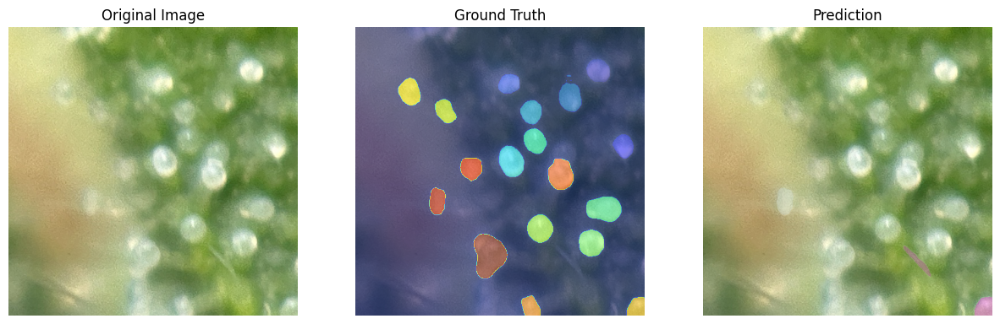

----------- Analysis for IMG_0045_p10 ----------- 



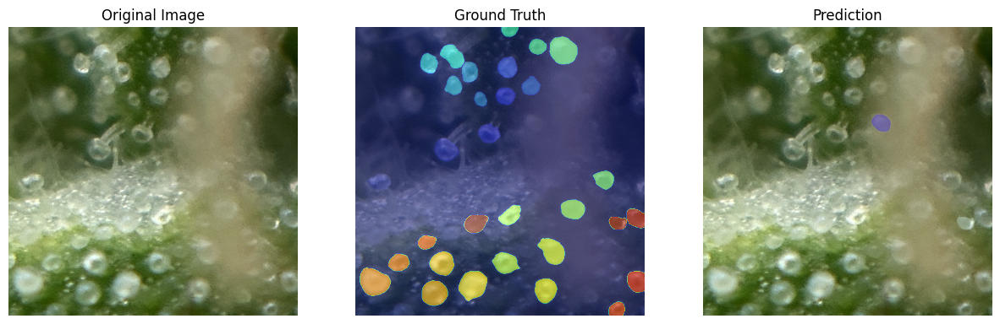

----------- Analysis for IMG_0045_p14 ----------- 



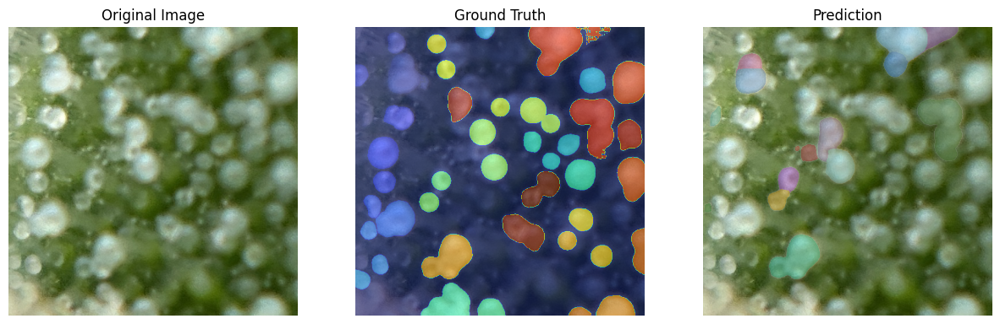

----------- Analysis for IMG_0045_p18 ----------- 



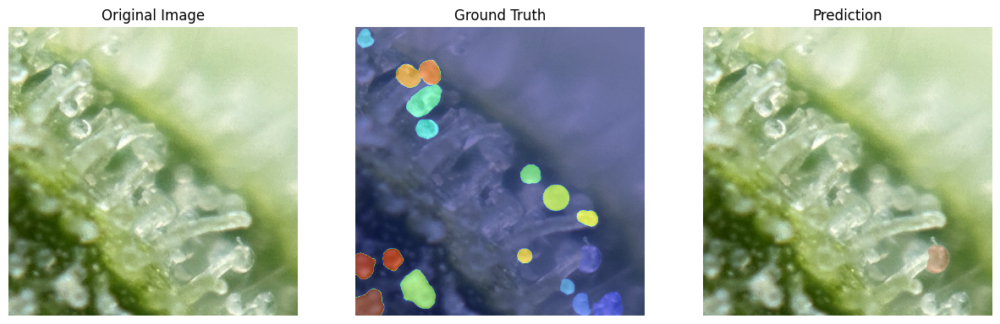

----------- Analysis for IMG_0045_p19 ----------- 



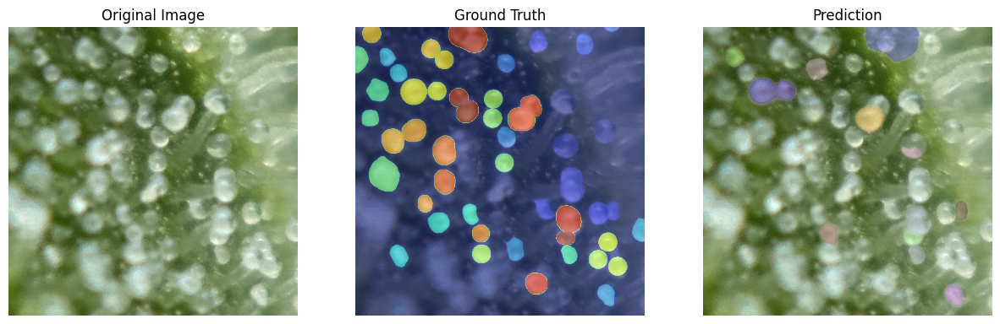

----------- Analysis for IMG_0045_p28 ----------- 



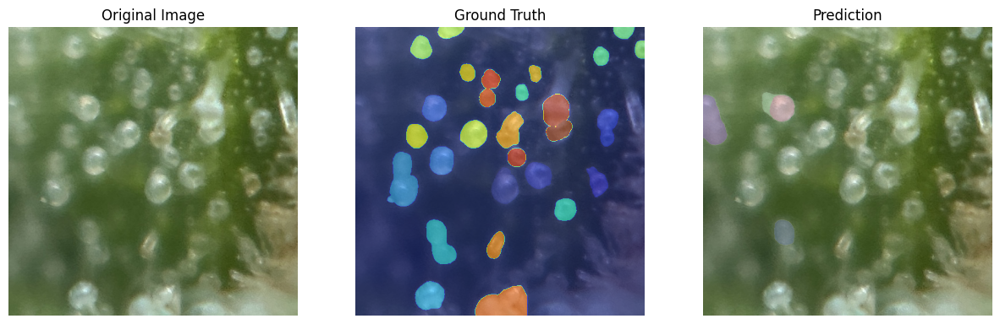

----------- Analysis for IMG_0045_p34 ----------- 



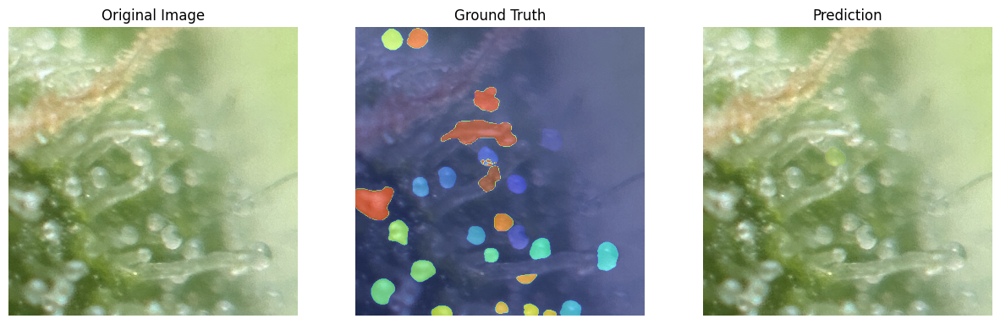

----------- Analysis for IMG_0045_p35 ----------- 



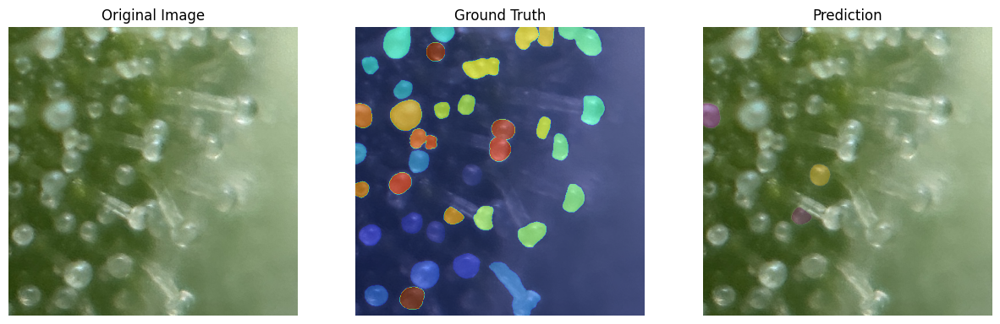

----------- Analysis for IMG_0045_p9 ----------- 



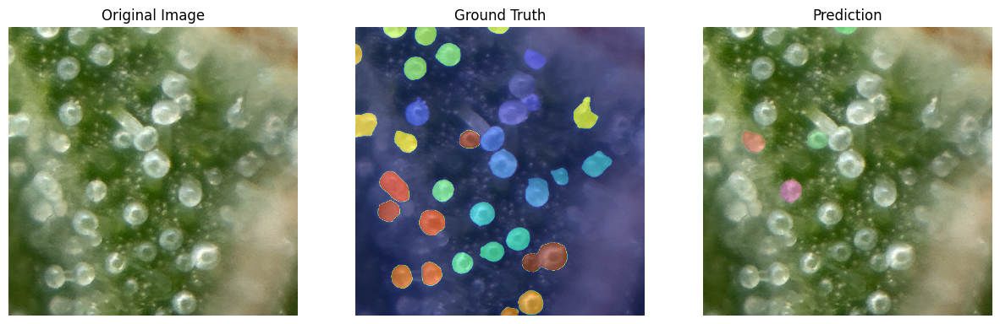

----------- Analysis for IMG_0061_p11 ----------- 



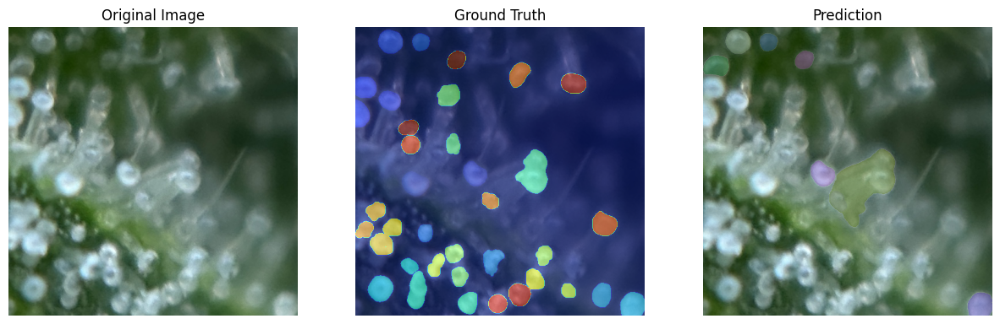

----------- Analysis for IMG_0061_p12 ----------- 



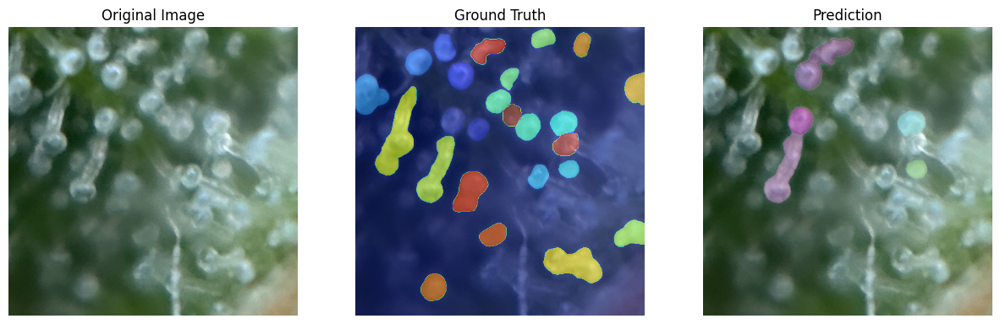

----------- Analysis for IMG_0061_p16 ----------- 



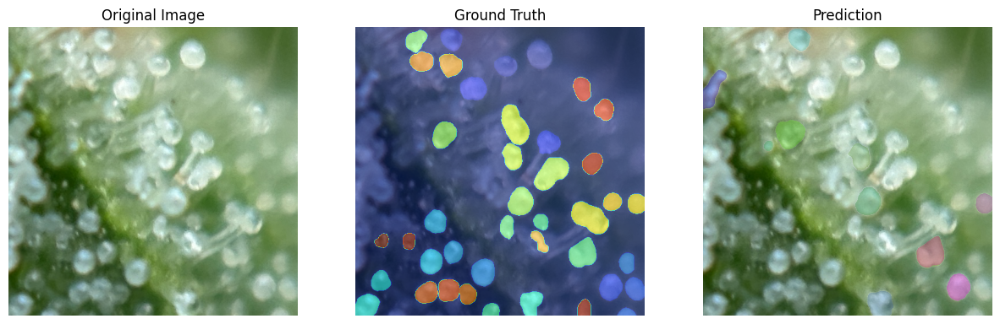

----------- Analysis for IMG_0061_p3 ----------- 



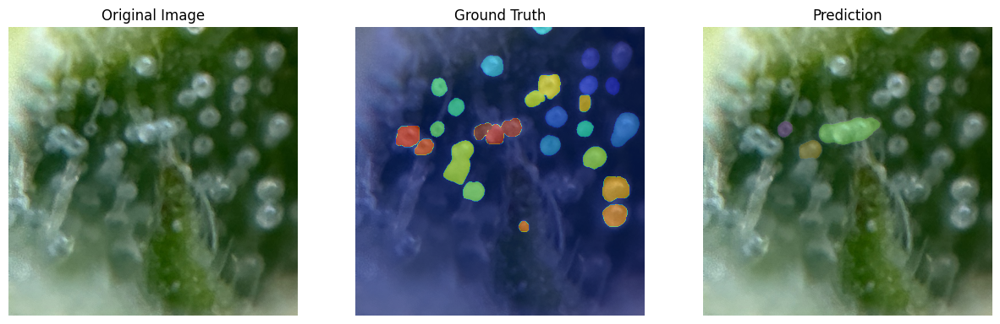

----------- Analysis for IMG_0061_p7 ----------- 



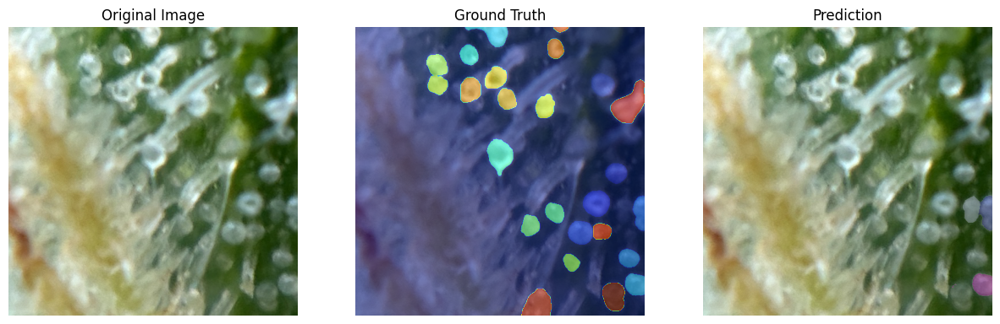

----------- Analysis for IMG_0062_p11 ----------- 



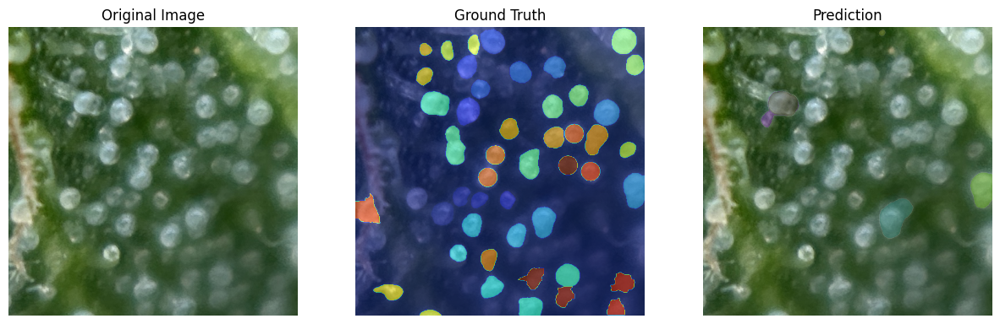

----------- Analysis for IMG_0072_p11 ----------- 



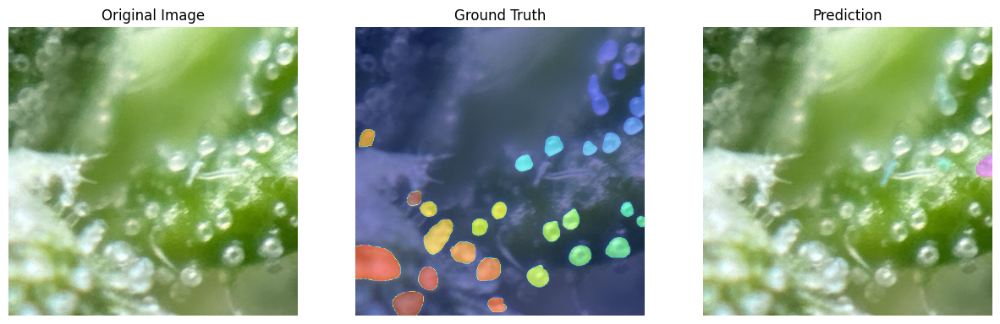

----------- Analysis for IMG_0072_p12 ----------- 



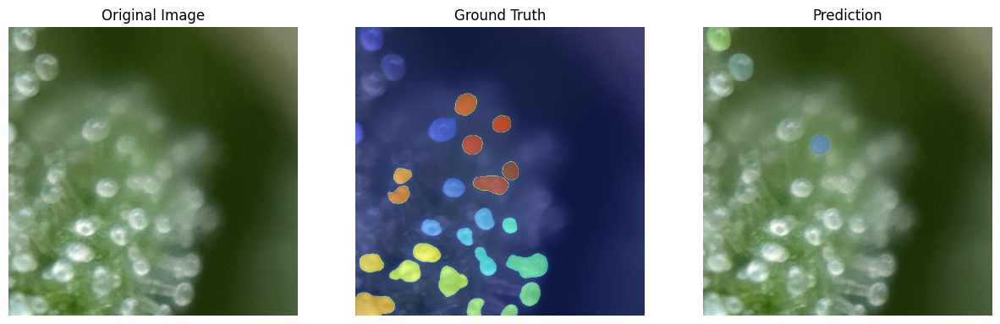

----------- Analysis for IMG_0072_p14 ----------- 



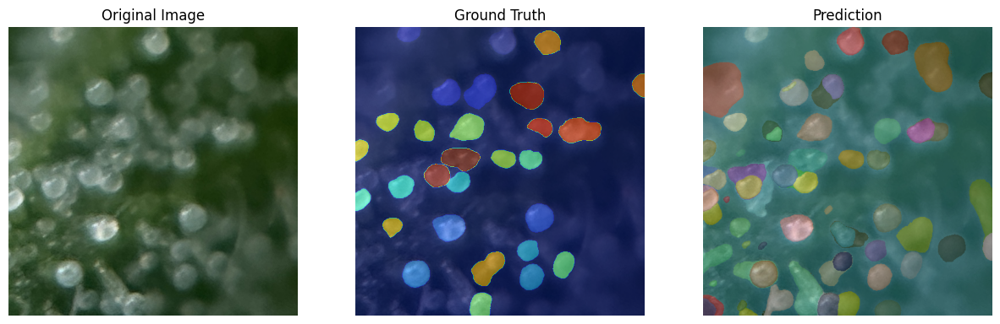

----------- Analysis for IMG_0072_p25 ----------- 



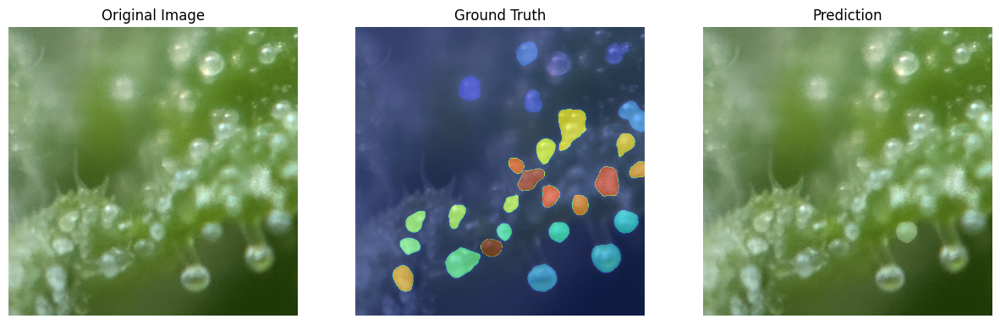

----------- Analysis for IMG_9979_p12 ----------- 



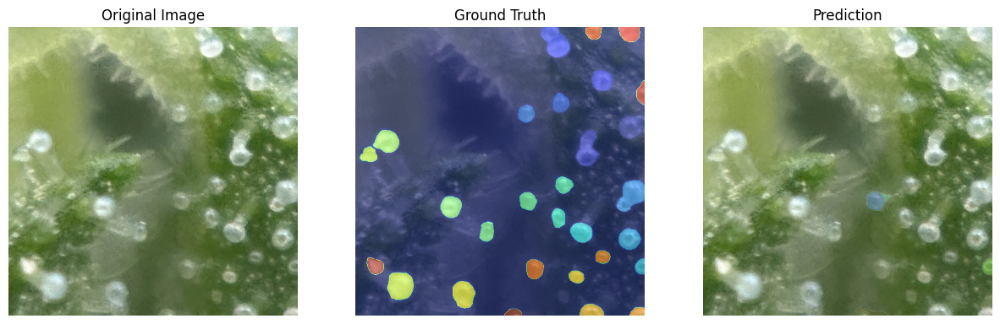

----------- Analysis for IMG_9979_p13 ----------- 



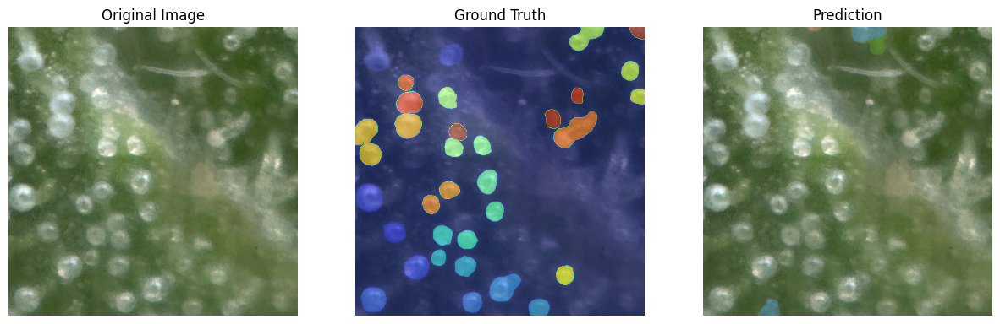

----------- Analysis for IMG_9979_p19 ----------- 



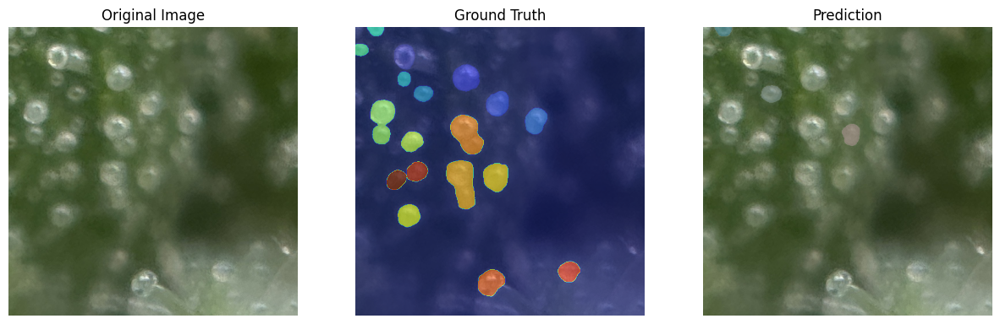

----------- Analysis for IMG_9979_p26 ----------- 



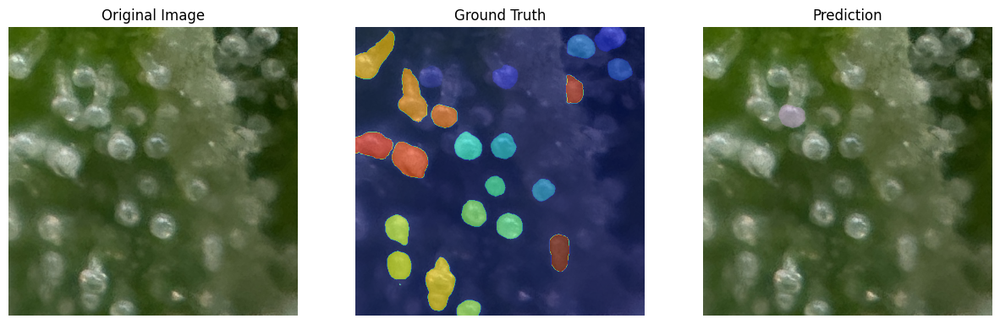

----------- Analysis for IMG_9998_p14 ----------- 



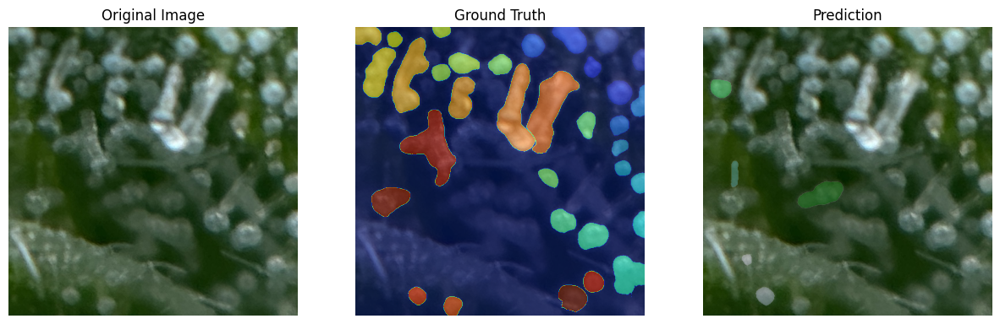

----------- Analysis for IMG_9998_p18 ----------- 



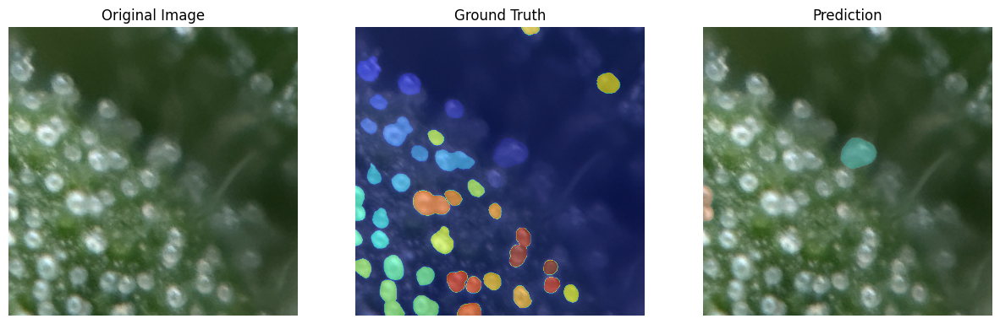

----------- Analysis for IMG_9998_p19 ----------- 



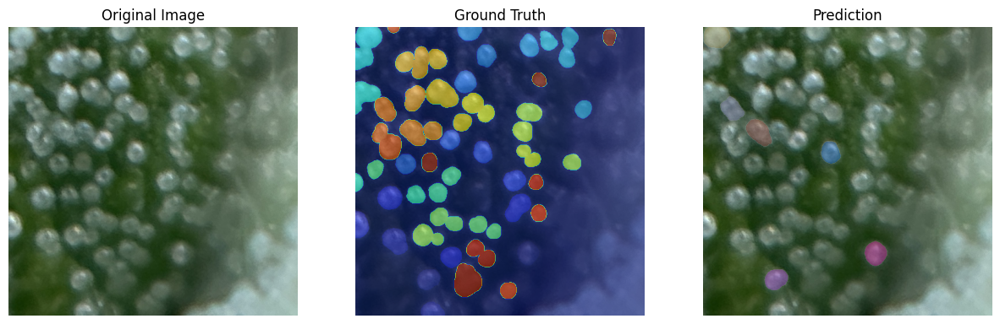

----------- Analysis for IMG_9998_p32 ----------- 



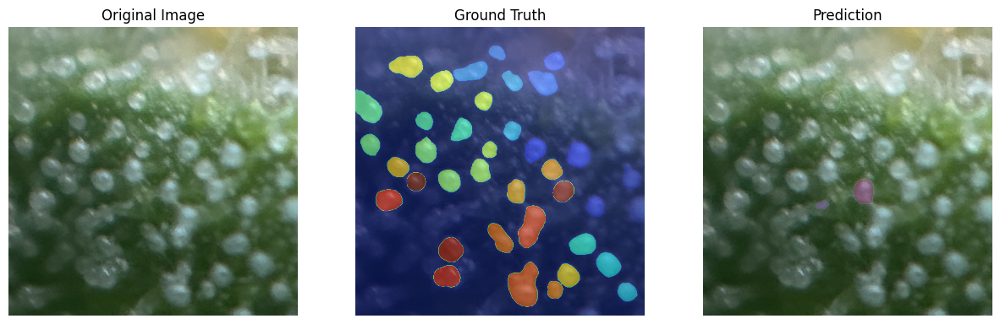

In [ ]:
for sample in ground_truth.keys():
  print(f"----------- Analysis for {sample} ----------- \n")
  plot_masks(ground_truth[sample], filtered_SAM_pred[sample])